# Financial Market Trends Analysis

With the power of Artificial Intelligence implemented into everyone's lives. From the broader perspective, it has improved the revenue for a lot of companies. This analysis brings you into the financial market trends in the last decade.

## Importing Libraries

The code begins by importing various libraries which can be categorized as follows:

### Data Handling and Statistical Analysis:

* pandas: Provides data structures and data analysis tools for the Python programming language.
* pandas_datareader: Allows reading stock information directly into a pandas dataframe.
* numpy: Provides mathematical tools and functions to operate on these large arrays and matrices of numerical data.
* scipy.stats: Provides a vast array of statistical functions.

### Data Visualization:

* matplotlib.pyplot & seaborn: Both are visualization libraries which allow for generating a variety of plots and charts in Python.
* plotly: A graphing library that makes interactive, publication-quality graphs.

### Optimization and Allocation:

* pypfopt: A financial portfolio optimization library that includes tools like the Black-Litterman model.

### Financial Data:

* quantstats: Provides various utilities and metrics commonly used in quantitative finance.
* ta: Provides tools for technical analysis.
* yfinance: A way to extract financial data using Yahoo Finance.

### Modeling:

* sklearn.linear_model: For linear modeling.

### Other Utilities:

* plotly.offline: Allows for offline plotting using plotly.
* datetime: Provides classes to manipulate dates and times.
* warnings: Used to suppress and manage warnings.

In [2]:
# Importing Libraries

# Data handling and statistical analysis 
import pandas as pd
from pandas_datareader import data
import numpy as np
from scipy import stats

# Data visualization 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Optimization and allocation
from pypfopt.efficient_frontier import EfficientFrontier
from pypfopt import risk_models
from pypfopt import expected_returns
from pypfopt import black_litterman, BlackLittermanModel

# Financial data 
import quantstats as qs
import ta
import yfinance as yf

# Linear Regression Model
from sklearn.linear_model import LinearRegression

# Enabling Plotly offline
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)

# Datetime and hiding warnings 
import datetime as dt
import warnings
warnings.filterwarnings("ignore")

## Fetching Data and Data Processing

### Fetching Daily Returns:

* Using the qs.utils.download_returns function from the quantstats library, the daily returns for six US stocks (NVIDIA, META, Microsoft, Black Rock, Goldman Sachs, and Google) are fetched.

### Setting the Time Window:

* For each stock's daily return data, the code limits the date range to between '2013-08-11' and '2023-08-24'. This is done using the .loc[] functionality from pandas.

In [3]:
# Getting daily returns for 4 different US stocks in the same time window
nvda = qs.utils.download_returns('NVDA')
nvda = nvda.loc['2013-08-11':'2023-08-24']

meta = qs.utils.download_returns('META')
meta = meta.loc['2013-08-11':'2023-08-24']

msft = qs.utils.download_returns('MSFT')
msft = msft.loc['2013-08-11':'2023-08-24']

blk = qs.utils.download_returns('BLK')
blk = blk.loc['2013-08-11':'2023-08-24']

gs = qs.utils.download_returns('GS')
gs = gs.loc['2013-08-11':'2023-08-24']

googl = qs.utils.download_returns('GOOGL')
googl = googl.loc['2013-08-11':'2023-08-24']

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


Using the `quantstats` library, daily returns for the six aforementioned companies are fetched for a specific date range spanning from August 11, 2013, to August 24, 2023.
The data for each stock is filtered to only include the returns within the date range '2013-08-11' to '2023-08-24', ensuring a consistent and comparable time window across all stocks.

### Timezone Conversion for Data

The code provided is focusing on adjusting the time zones associated with the datetime indices of the financial datasets for each of the six companies. Let's dive into each action:

#### 1. **Localizing to UTC**:

For each company's dataset, the datetime index is first localized to the Coordinated Universal Time (UTC) using the `tz_localize('UTC')` method. This step ensures that a standard UTC timezone is set for each datetime index if it wasn't already.

For example:
`nvda.index = nvda.index.tz_localize('UTC')` 

This means that the datetime index of the `nvda` dataframe is now set to UTC.

#### 2. **Removing Timezone Information**:

After localizing to UTC, the code then proceeds to remove the timezone information altogether using the `tz_convert(None)` method. The intention behind this might be to simplify further data processing, as timezone-naive datetime indices can sometimes be easier to work with.

Continuing our example:
`nvda.index = nvda.index.tz_convert(None)` 

This will ensure that the `nvda` dataframe's datetime index no longer has any timezone information associated with it.

#### 3. **Result**:

At the end of these operations, the datetime indices for all six company datasets (`nvda`, `meta`, `msft`, `blk`, `gs`, `googl`) are timezone-naive and originally derived from a standardized UTC localization.

By doing this, the analysis can proceed without concerns about mismatches in time zones or the complexities of handling timezone-aware datetime objects.

In [4]:
# Converting timezone
nvda.index = nvda.index.tz_localize('UTC').tz_convert(None)
meta.index = meta.index.tz_localize('UTC').tz_convert(None)
msft.index = msft.index.tz_localize('UTC').tz_convert(None)
blk.index = blk.index.tz_localize('UTC').tz_convert(None)
gs.index = gs.index.tz_localize('UTC').tz_convert(None)
googl.index = googl.index.tz_localize('UTC').tz_convert(None)

## Visualizing Daily Returns for Each Company

#### 1. **Setting up Visual Indicators**:

`print('\n')` is used multiple times throughout the code to add space between the plots and the titles, ensuring clear separation and readability when the outputs are displayed.

#### 2. **Plotting Daily Returns**:

For each company, the daily returns are plotted using the `qs.plots.daily_returns` function. 

- **Function Used**: The `qs.plots.daily_returns()` function is specifically designed to visualize the daily returns of a given dataset.
- **Arguments**:
    - The first argument is the data for the daily returns of a specific company.
    - The `benchmark=None` argument ensures that the plot doesn't compare the stock's returns to any benchmark, focusing solely on the stock's performance.

For instance, the code:

```python
print('\nNVDIA Daily Returns Plot:\n')
qs.plots.daily_returns(nvda, benchmark=None)

This process of displaying the title and plotting the daily returns is repeated for all six companies: NVIDIA, META, Microsoft, BlackRock, Goldman Sachs, and Alphabet Inc. (referred to in the code by its stock ticker, 'GOOGL').




NVDIA Daily Returns Plot:



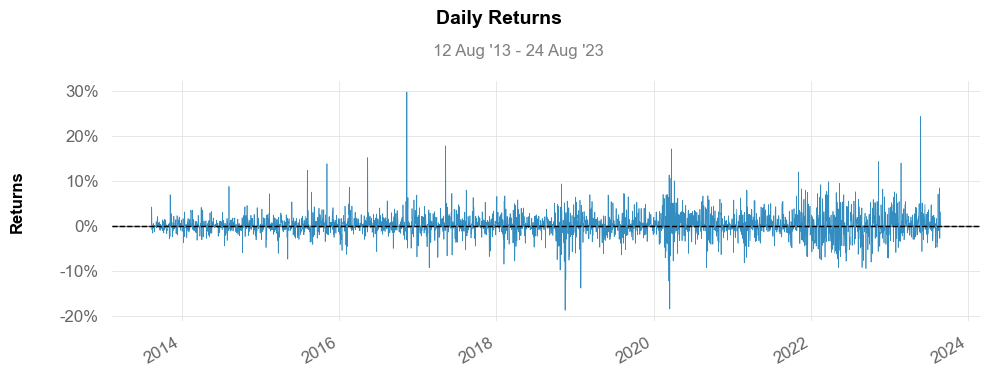






META Daily Returns Plot:



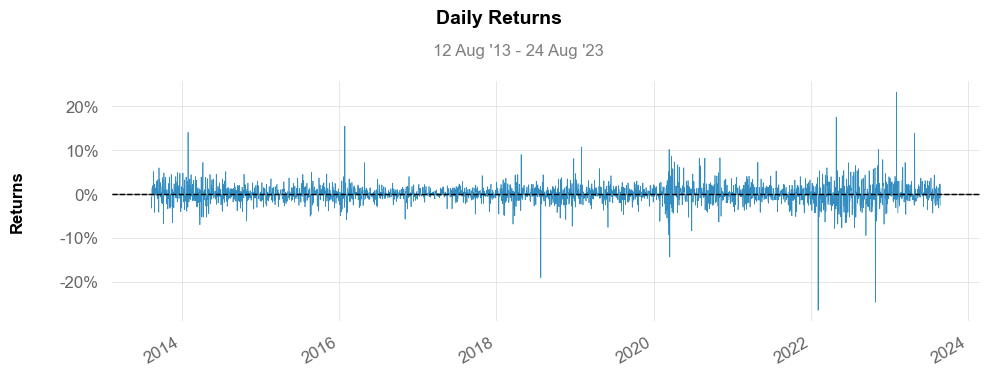






Microsoft Daily Returns Plot:



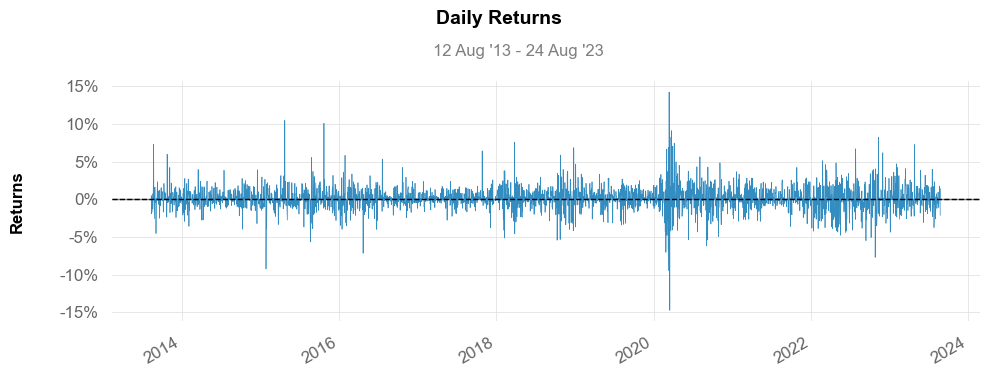






BlackRock Daily Returns Plot:



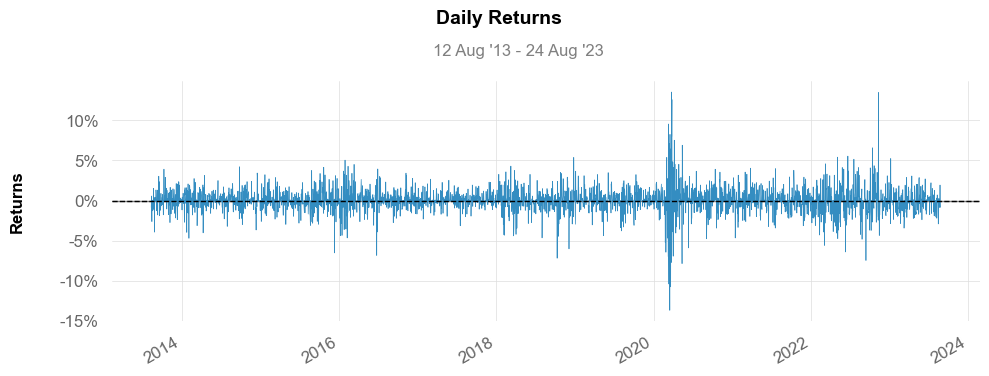






Goldman Sachs Daily Returns Plot:



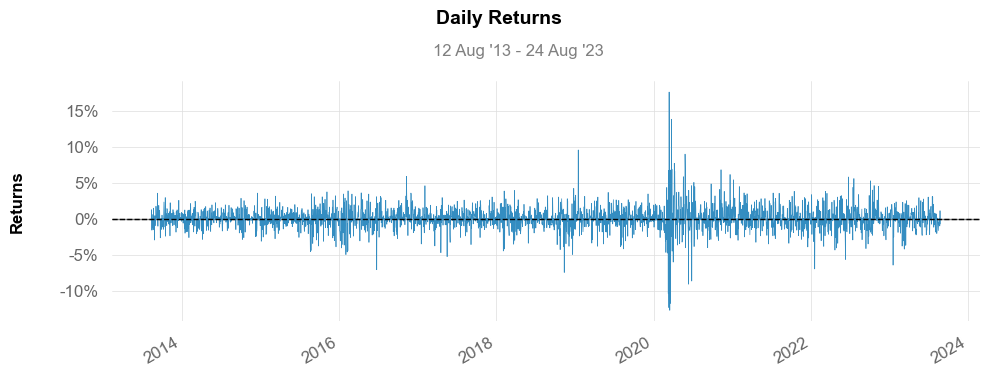






Alphabet.Inc Daily Returns Plot:



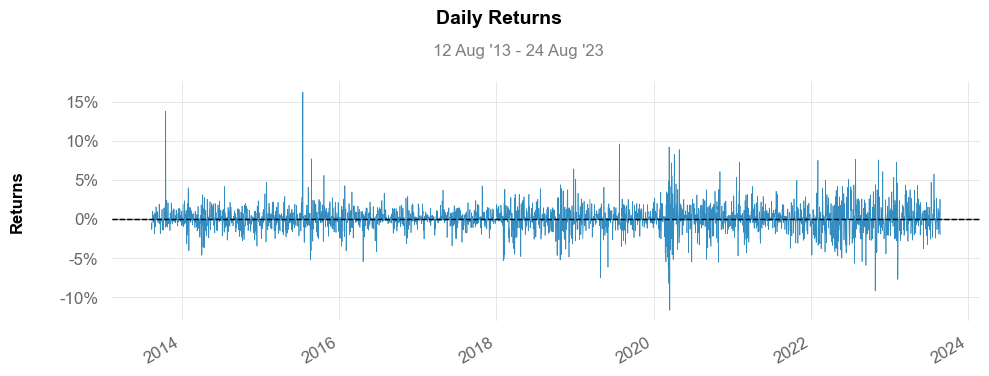

In [5]:
# Plotting Daily Returns for each stock
print('\n')
print('\nNVDIA Daily Returns Plot:\n')
qs.plots.daily_returns(nvda, benchmark=None)
print('\n')
print('\n')
print('\nMETA Daily Returns Plot:\n')
qs.plots.daily_returns(meta, benchmark=None)
print('\n')
print('\n')
print('\nMicrosoft Daily Returns Plot:\n')
qs.plots.daily_returns(msft, benchmark=None)
print('\n')
print('\n')
print('\nBlackRock Daily Returns Plot:\n')
qs.plots.daily_returns(blk, benchmark=None)
print('\n')
print('\n')
print('\nGoldman Sachs Daily Returns Plot:\n')
qs.plots.daily_returns(gs, benchmark=None)
print('\n')
print('\n')
print('\nAlphabet.Inc Daily Returns Plot:\n')
qs.plots.daily_returns(googl, benchmark=None)

Upon execution, the code will display a series of plots, each representing the daily returns of the respective company over the specified date range. These visualizations give a clear picture of how each stock performed on a day-to-day basis, highlighting volatility, major spikes, or drops in returns.

It looks clunky but it shows all the daily returns in detail, let's say what it looks like after we found the cumulative returns for each company

## Visualizing Cumulative Returns for Each Company

The provided code aims to display the cumulative returns for each of the six key companies. This is achieved through the use of the `quantstats` library, which has specialized plotting functions tailored for financial data. Let's delve into the details:

#### 1. **Visual Separation**:

`print('\n')` is strategically used at various points within the code to introduce spacing between the plots and their titles, ensuring a cleaner presentation when the outputs are rendered.

#### 2. **Plotting Cumulative Returns**:

For every company, the cumulative returns are illustrated using the `qs.plots.returns` function.

- **Function Utilized**: The `qs.plots.returns()` function is structured to plot the cumulative returns of a dataset over time.
- **Argument**:
    - The singular argument is the data representing the daily returns of a specific company.

For instance, the segment:

```python
print('\nNVDIA Cumulative Returns Plot\n')
qs.plots.returns(nvda)
```
#### 3. Iterative Process for All Companies:
This method of printing the title followed by plotting the cumulative returns is reiterated for all six entities: NVIDIA, META, Microsoft, BlackRock, Goldman Sachs, and Alphabet Inc. (denoted in the code via its stock symbol, 'GOOGL').





NVDIA Cumulative Returns Plot



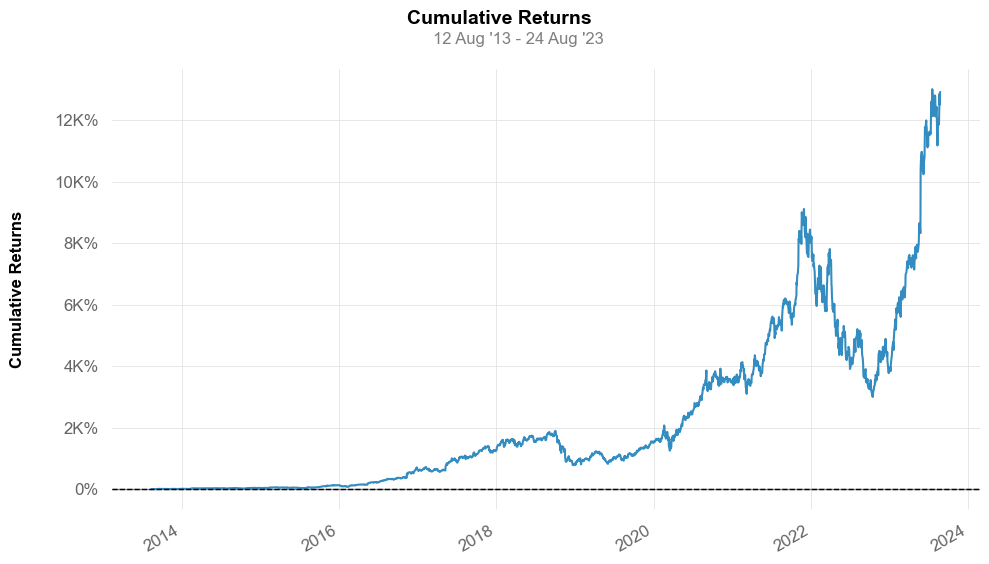






META Cumulative Returns Plot



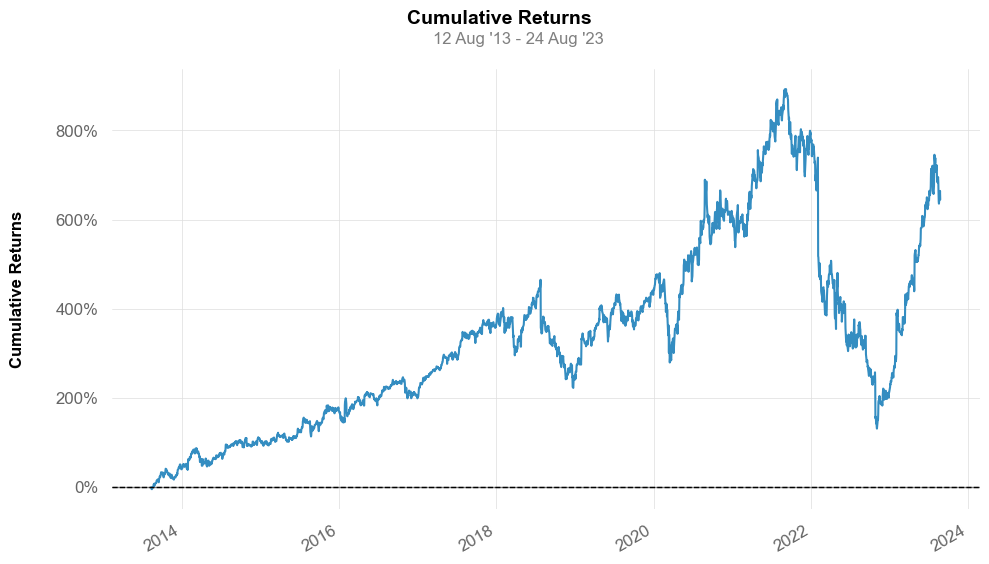






Microsoft Cumulative Returns Plot



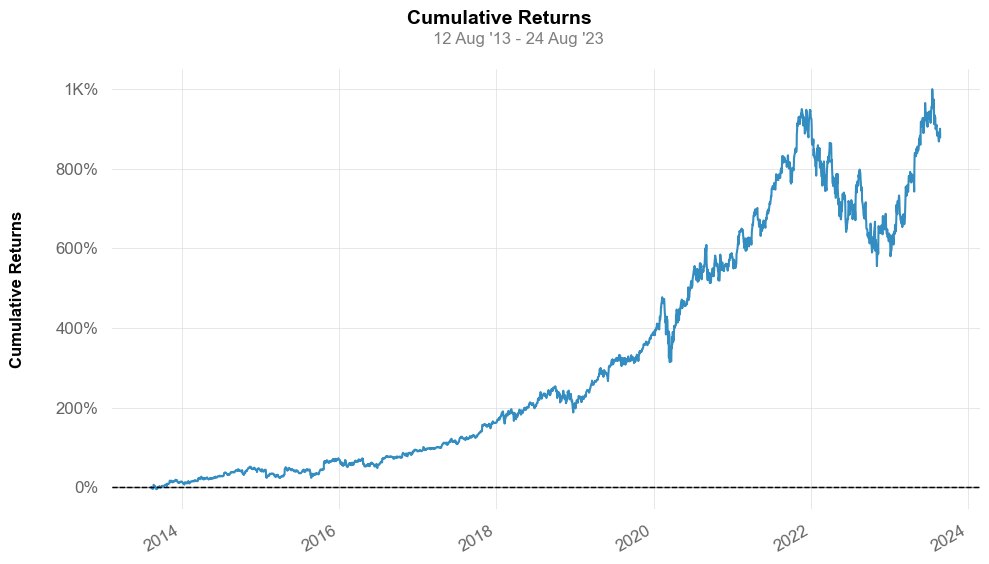






BLACK ROCK Cumulative Returns Plot



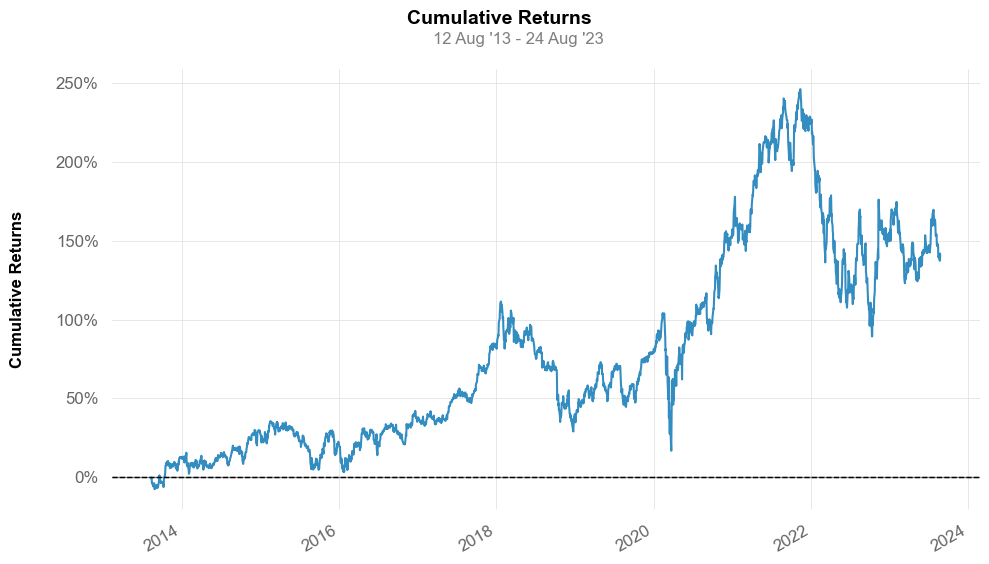






Goldman Sachs Cumulative Returns Plot



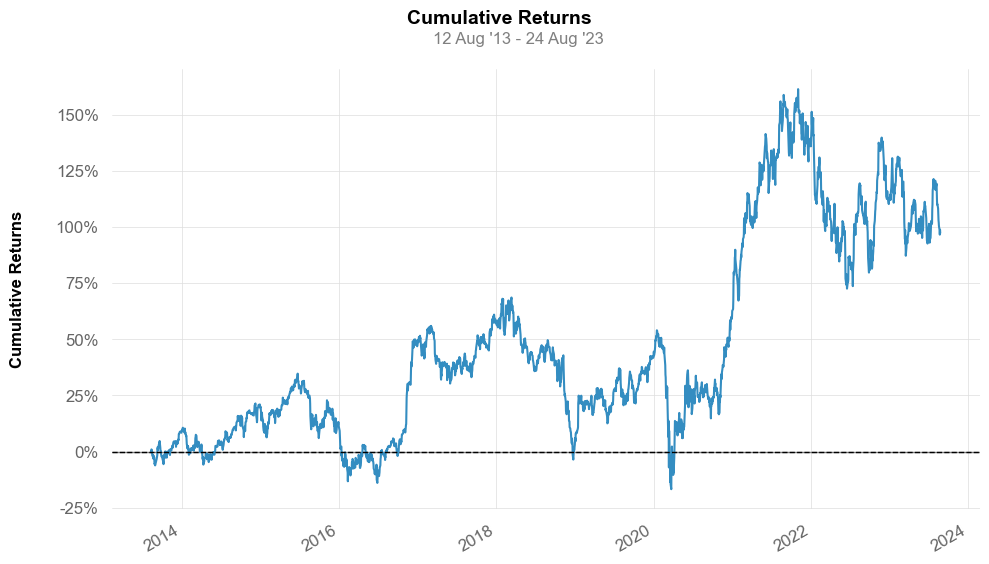






Alphabet.Inc Cumulative Returns Plot



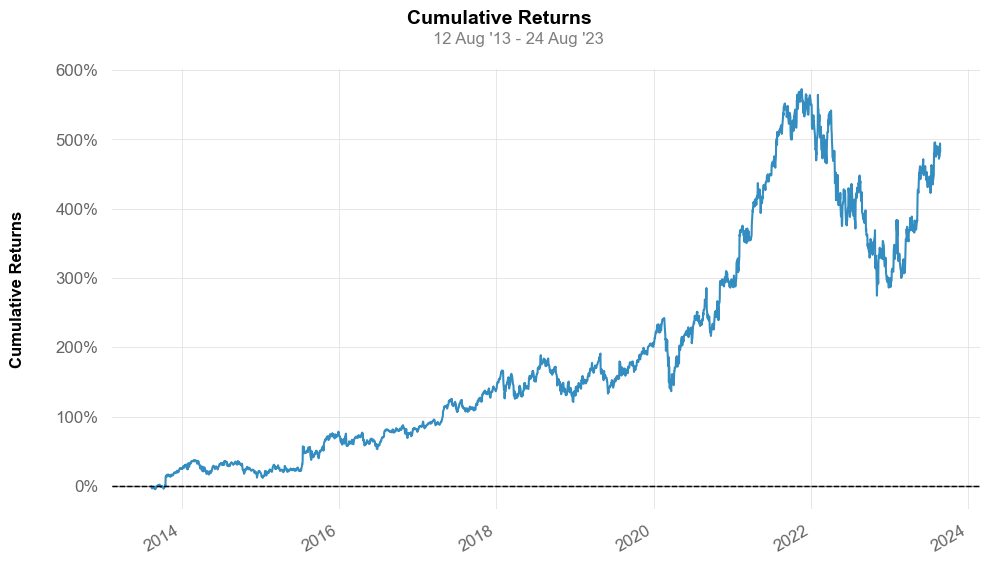

In [6]:
# Plotting Cumulative Returns for each stock
print('\n')
print('\nNVDIA Cumulative Returns Plot\n')
qs.plots.returns(nvda)
print('\n')
print('\n')
print('\nMETA Cumulative Returns Plot\n')
qs.plots.returns(meta)
print('\n')
print('\n')
print('\nMicrosoft Cumulative Returns Plot\n')
qs.plots.returns(msft)
print('\n')
print('\n')
print('\nBLACK ROCK Cumulative Returns Plot\n')
qs.plots.returns(blk)
print('\n')
print('\n')
print('\nGoldman Sachs Cumulative Returns Plot\n')
qs.plots.returns(gs)
print('\n')
print('\n')
print('\nAlphabet.Inc Cumulative Returns Plot\n')
qs.plots.returns(googl)

It's evident from the data that NVIDIA leads the pack, boasting an astounding cumulative return peaking over 12,000%. This surge is, in part, attributable to media reports and NVIDIA's introduction of innovative AI-driven technologies, which seem to have significantly augmented the company's returns.

Following NVIDIA, Microsoft stands out with its peak just around 1,000%.

The subsequent rankings are as follows: META with returns slightly above 800%, Alphabet (known for its primary subsidiary, Google) achieving over 500%, BlackRock nearing 250%, and Goldman Sachs just crossing the 150% threshold.

However, it's imperative to remember that investing decisions shouldn't be based solely on cumulative returns. A comprehensive analysis requires a holistic view, encompassing various indicators and a keen understanding of potential risks. While a 12,000% return is undeniably substantial, the stock market often values consistent, gradual growth as much as it does dramatic spikes.

## Visualizing Daily Returns with Histograms

The provided code block visualizes the distribution of daily returns for each of the six companies. It uses histograms, which are a common way to depict the frequency of data points in various ranges. Here's a detailed breakdown:

#### 1. **Creating Visual Separation**:

The multiple `print('\n')` statements serve to introduce spaces between each histogram and its title, ensuring clarity and neat presentation when the plots are displayed.

#### 2. **Plotting Histograms for Daily Returns**:

Each company's daily returns are depicted as a histogram using the `qs.plots.histogram` function.

- **Function**: `qs.plots.histogram()` is specifically built to visualize the distribution of financial data in a histogram format.
- **Arguments**:
    - The primary argument is the data for the daily returns of a particular company.
    - The `resample='D'` argument ensures that the data is resampled at a daily frequency, thereby focusing on daily returns.

For example, the segment:

```python
print('\nNVDIA Daily Returns Histogram')
qs.plots.histogram(nvda, resample = 'D')





NVDIA Daily Returns Histogram


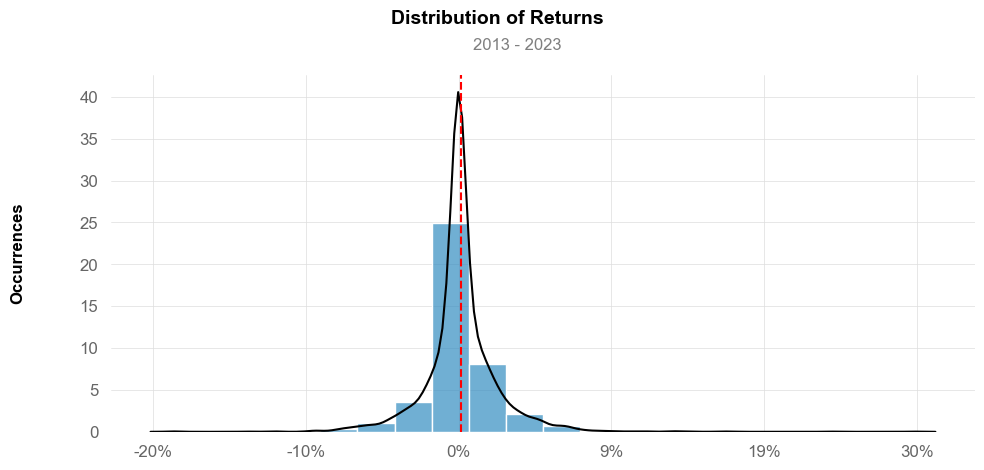




META Daily Returns Histogram


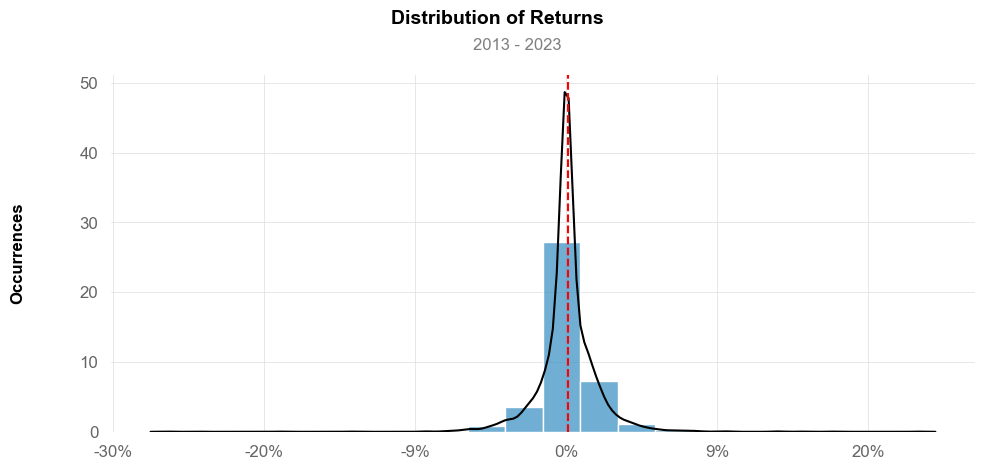




Microsoft Daily Returns Histogram


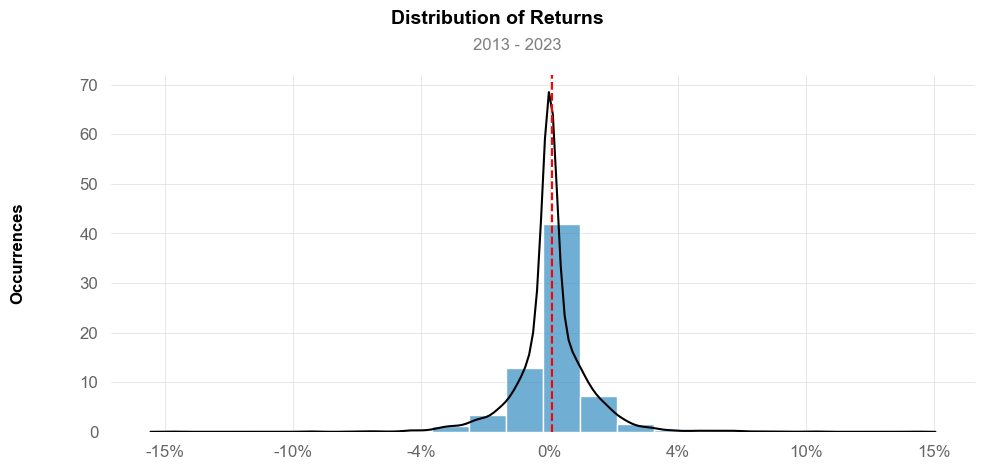




Black Rock Daily Returns Histogram


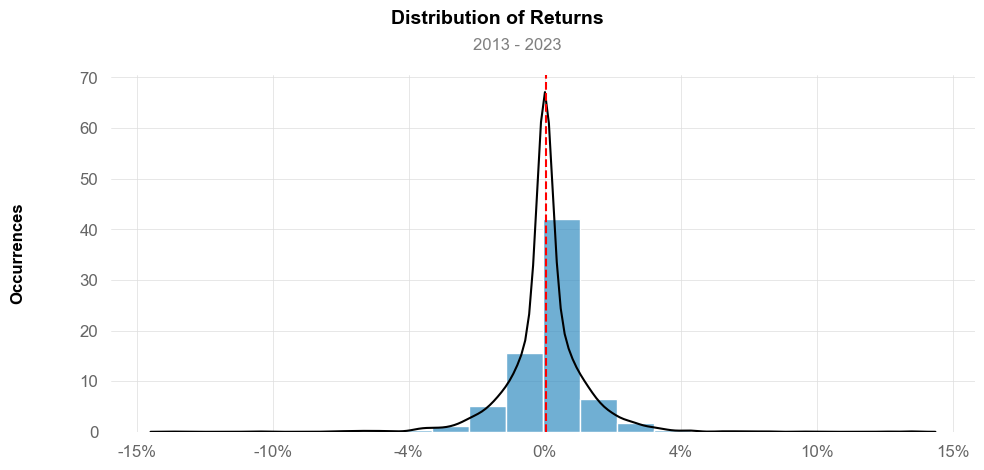




Goldman Sachs Daily Returns Histogram


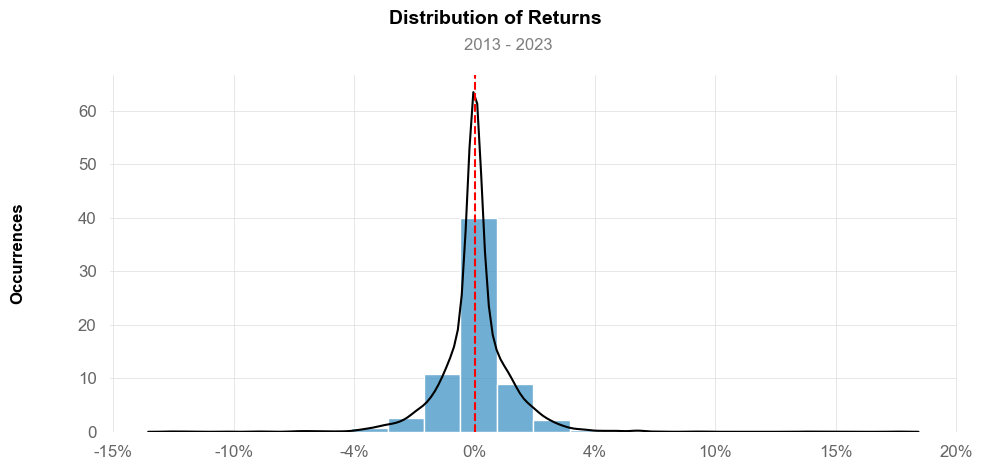




Alphabet.Inc Daily Returns Histogram


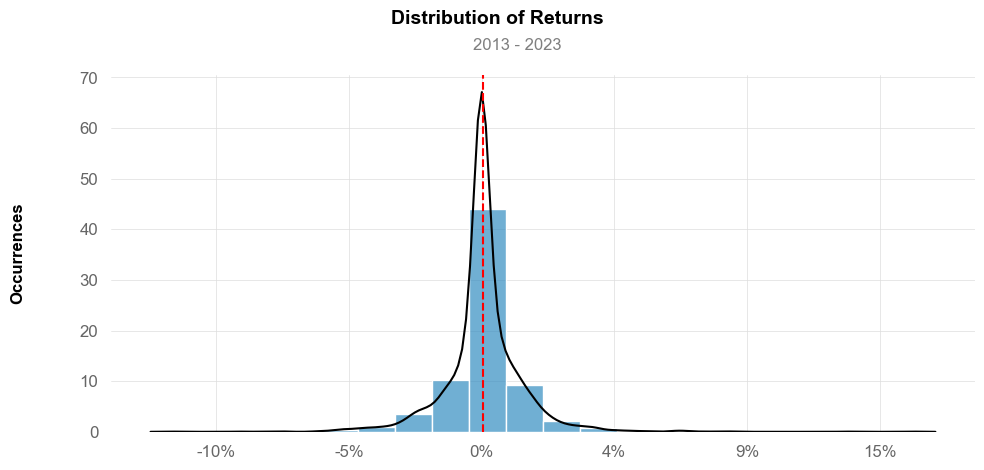

In [7]:
# Plotting histograms for daily returns 
print('\n')
print('\nNVDIA Daily Returns Histogram')
qs.plots.histogram(nvda, resample = 'D')
print('\n')
print('\nMETA Daily Returns Histogram')
qs.plots.histogram(meta, resample = 'D')
print('\n')
print('\nMicrosoft Daily Returns Histogram')
qs.plots.histogram(msft, resample = 'D')
print('\n')
print('\nBlack Rock Daily Returns Histogram')
qs.plots.histogram(blk, resample = 'D')
print('\n')
print('\nGoldman Sachs Daily Returns Histogram')
qs.plots.histogram(gs, resample = 'D')
print('\n')
print('\nAlphabet.Inc Daily Returns Histogram')
qs.plots.histogram(googl, resample = 'D')

NVDIA:
The histogram for NVIDIA peaks at 40 occurrences, suggesting that this return value was the most frequent during the observed period.
The daily returns ranged from a decrease of 20% to an increase of 30%. This relatively broad range indicates considerable volatility.
The most common return values occurred 25 times.
The red dashed line positioned at 0% serves as a marker, differentiating positive from negative returns.

META:
META's histogram has its highest point at 48 occurrences.
The daily returns for META ranged between -30% and 20%, indicating even more volatility than NVIDIA.
The return that was most frequently observed happened 28 times.

Microsoft:
Microsoft exhibits a peak frequency at a significant 70 occurrences, suggesting a stable financial performance with recurring daily returns.
Its daily returns varied between -15% and 15%, presenting a narrower range than both NVIDIA and META. This could signify less volatility for Microsoft during the period.
The most frequently observed return occurred 41 times.

BlackRock:
BlackRock's bell curve peaks at 68 occurrences, almost paralleling Microsoft in terms of stability.
The returns ranged between -15% and 15% — similar to Microsoft.
The top frequency for a specific daily return value is 41 occurrences.

Goldman Sachs:
The histogram for Goldman Sachs reaches its zenith at 62 occurrences.
With a daily return range from -15% to 20%, it signifies a somewhat balanced volatility level — not as extreme as META, yet not as stable as Microsoft.
The most common return value for Goldman Sachs was noted 40 times.

Alphabet Inc.:
Alphabet Inc.'s distribution peaks at 68 occurrences.
The returns fluctuate between -10% and 15%. The relatively tighter range may suggest that Alphabet Inc. had fewer extreme daily performances compared to some other companies on the list.
The most frequent return value appeared 45 times.

These histograms, and the statistics derived from them, serve as a barometer for investors, enabling them to understand each company's financial stability, risk, and performance over the analyzed period. While all companies seem to follow a general trend of normal distribution, the nuances in their ranges and peak frequencies underscore the unique financial journeys each has embarked upon.

## Analyzing Kurtosis with Quantstats


The code chunk is utilizing the quantstats library to measure the kurtosis of daily returns for six companies. Kurtosis is a statistical measure used to describe the distribution of observed data around the mean.

In [8]:
# Using quantstats to measure kurtosis
print('\n')
print("NVDIA's kurtosis: ", qs.stats.kurtosis(nvda).round(2))
print('\n')
print("META's kurtosis: ", qs.stats.kurtosis(meta).round(2))
print('\n')
print("Microsoft's kurtosis: ", qs.stats.kurtosis(msft).round(3))
print('\n')
print("BlackRock 's kurtosis: ", qs.stats.kurtosis(blk).round(3))
print('\n')
print("Goldman Sachs 's kurtosis: ", qs.stats.kurtosis(gs).round(3))
print('\n')
print("Google's kurtosis: ", qs.stats.kurtosis(googl).round(3))




NVDIA's kurtosis:  10.11


META's kurtosis:  19.47


Microsoft's kurtosis:  7.762


BlackRock 's kurtosis:  8.632


Goldman Sachs 's kurtosis:  10.242


Google's kurtosis:  7.898


NVDIA's kurtosis: 10.11 — A positive kurtosis value indicates that the distribution has heavy tails and a sharp peak, compared to the normal distribution.

META's kurtosis: 19.47 — This value is notably higher than NVIDIA's, suggesting even heavier tails and possibly more outliers.

Microsoft's kurtosis: 7.762 — Although this value is positive, indicating the presence of heavy tails, it's lower than NVIDIA's and META's, implying fewer extreme values.

BlackRock's kurtosis: 8.632 — Slightly higher than Microsoft's, but still suggesting the presence of heavy tails.

Goldman Sachs's kurtosis: 10.242 — Comparable to NVIDIA's, this value again suggests a distribution with heavy tails and a sharp peak.

Google's kurtosis: 7.898 — This value is close to Microsoft's, suggesting a somewhat similar distribution shape.

Kurtosis provides insights into the tails of the distribution. In the context of financial returns:

High positive kurtosis suggests potential outliers, which might be significant gains or losses.
A kurtosis close to 3 (for excess kurtosis) would indicate a distribution similar to a normal distribution. Given that the kurtosis values for all companies are notably higher than 3, it implies all have distributions with heavier tails than the normal distribution.


It's important for investors to consider kurtosis. High kurtosis implies potential outlier events (like sudden market crashes or booms), which could be risky.

## Analyzing Skewness with Quantstats

The code segment is leveraging the quantstats library to determine the skewness of daily returns for six companies. Skewness is a measure that describes the shape of a distribution. It provides insights into the symmetry or asymmetry of the distribution around its mean.

In [9]:
# Measuring skewness with quantstats
print('\n')
print("NVDIA's skewness: ", qs.stats.skew(nvda).round(2))
print('\n')
print("META's skewness: ", qs.stats.skew(meta).round(2))
print('\n')
print("Microsoft's skewness: ", qs.stats.skew(msft).round(3))
print('\n')
print("BlackRock 's skewness: ", qs.stats.skew(blk).round(3))
print('\n')
print("Goldman Sachs 's skewness: ", qs.stats.skew(gs).round(3))
print('\n')
print("Google's skewness: ", qs.stats.skew(googl).round(3))



NVDIA's skewness:  0.7


META's skewness:  -0.46


Microsoft's skewness:  0.155


BlackRock 's skewness:  0.086


Goldman Sachs 's skewness:  0.105


Google's skewness:  0.467


NVDIA's skewness: 0.7 — A positive skewness indicates that the distribution has a longer right tail. This means NVIDIA has more frequent small losses and a few large gains.

META's skewness: -0.46 — Negative skewness shows that the distribution has a longer left tail. For META, there are more frequent small gains and a few significant losses.

Microsoft's skewness: 0.155 — This positive but relatively small value suggests a slight skewness to the right, indicating a few larger gains than losses.

BlackRock's skewness: 0.086 — This small positive value indicates a distribution that is almost symmetric but slightly skewed to the right.

Goldman Sachs's skewness: 0.105 — Another positive value but relatively small, suggesting more or less symmetric distribution with a slight right skew.

Google's skewness: 0.467 — This moderate positive skewness suggests that Google's distribution leans more to the right, with a longer right tail.

Skewness offers insights into the distribution's tails and potential asymmetry:

Positive Skewness: The distribution's right tail is longer; more frequent small losses and less frequent large gains.

Negative Skewness: The distribution's left tail is longer; more frequent small gains and less frequent large losses.

Skewness close to 0: The distribution is approximately symmetric.

For investors, understanding skewness can provide insights into the type of returns they might expect. A negative skewness might indicate an investment that has frequent small gains but a risk of significant losses.

## Calculating Standard Deviations


This segment of code is focused on calculating the standard deviation for daily returns of six companies from 2010 to 2023. The standard deviation is a widely-used measure of the amount of variation or dispersion of a set of values. A low standard deviation indicates that the values tend to be close to the mean, while a high standard deviation indicates that the values are spread out over a broader range.

The standard deviation offers insights into the volatility and inherent risk of a stock. Higher standard deviations suggest greater volatility and potentially greater returns or losses, while lower values hint at steadiness and less dramatic changes in stock prices.

In [10]:
# Calculating Standard Deviations
print('\n')
print("NVDIA's Standard Deviation from 2010 to 2023: ", nvda.std().round(3))
print('\n')
print("\nMETA's Standard Deviation from 2010 to 2023: ", meta.std().round(3))
print('\n')
print("\nMicrosoft's Standard Deviation from 2010 to 2023: ", msft.std().round(3))
print('\n')
print("\nBlack Rocks's Standard Deviation from 2010 to 2023: ", blk.std().round(3))
print('\n')
print("\nGoldman Sachs's Standard Deviation from 2010 to 2023: ", gs.std().round(3))
print('\n')
print("\nGoogle's Standard Deviation from 2010 to 2023: ", googl.std().round(3))



NVDIA's Standard Deviation from 2010 to 2023:  0.029



META's Standard Deviation from 2010 to 2023:  0.024



Microsoft's Standard Deviation from 2010 to 2023:  0.017



Black Rocks's Standard Deviation from 2010 to 2023:  0.017



Goldman Sachs's Standard Deviation from 2010 to 2023:  0.018



Google's Standard Deviation from 2010 to 2023:  0.018


NVIDIA and META have the highest standard deviations among the companies listed, implying they may have been the most volatile stocks over the period.

Microsoft, BlackRock, Goldman Sachs, and Google have relatively similar and lower standard deviations, suggesting that their returns have been steadier during the 2010-2023 time frame.

In [11]:
# Merging daily returns into one dataframe
merged_df = pd.concat([nvda, meta, msft, blk, gs, googl], join = 'outer', axis = 1)
merged_df.columns = ['nvda', 'meta', 'msft', 'blk', 'gs', 'googl']
merged_df.head() # Displaying dataframe

,nvda,meta,msft,blk,gs,googl
Date,,,,,,
2013-08-12,-0.008282,-0.007273,0.005199,-0.008412,-0.002714,-0.005503
2013-08-13,0.003479,-0.031397,-0.019471,0.005751,0.012493,-0.004811
2013-08-14,0.042302,-0.009995,0.003723,-0.008899,-0.002260,-0.012982
2013-08-15,0.006653,-0.002456,-0.017311,-0.026071,-0.015856,-0.011669
2013-08-16,0.003966,0.014223,0.000315,0.000222,-0.000560,-0.003199


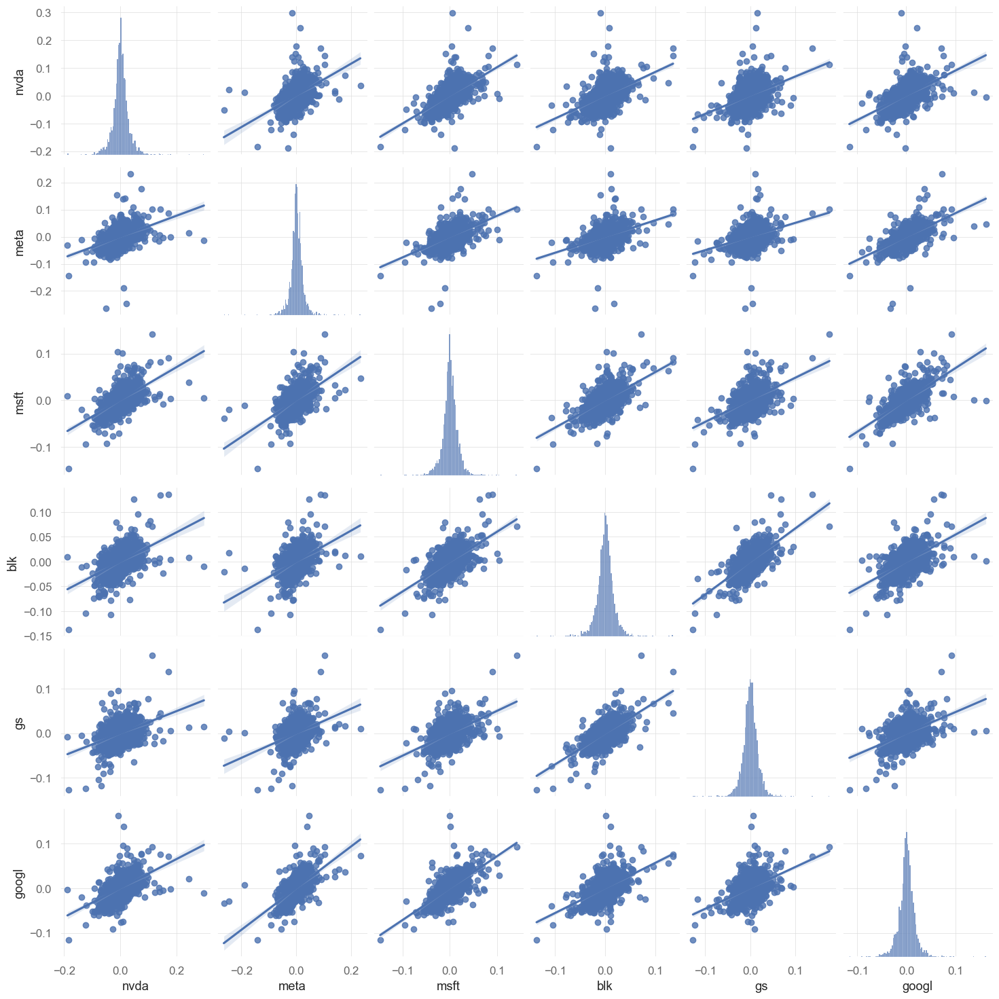

In [12]:
# Pairplots
sns.pairplot(merged_df, kind = 'reg')
plt.show()

All companies have normal distributed for their daily returns and their relationship is possively correlated.

## Generating a Correlation Matrix Heatmap


The code segment is dedicated to producing a heatmap of a correlation matrix for the stock returns of multiple companies. Correlation coefficients measure how closely two sets of data are related.

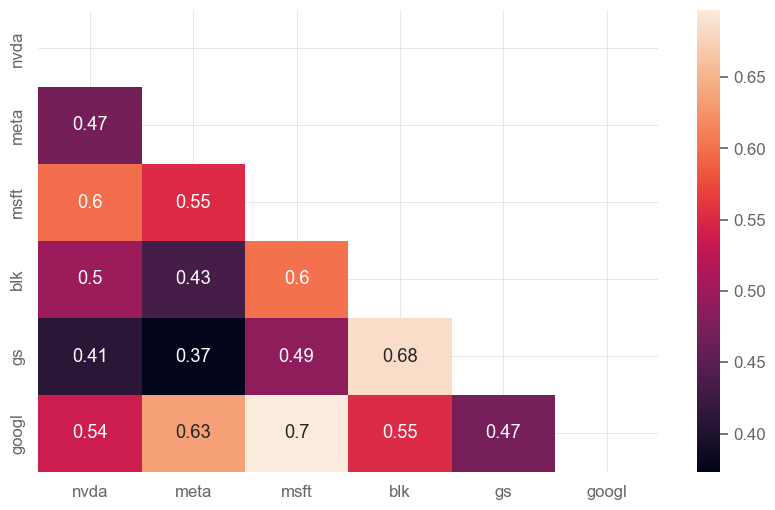

In [13]:
# Correlation Matrix
corr = merged_df.corr()
mask = np.zeros_like(corr, dtype=bool)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corr, annot=True, mask=mask)
plt.show()


The resulting heatmap shows the pairwise correlations between the stocks:

Diagonal: As any asset is perfectly correlated with itself, the diagonal has correlation values of 1 (though this is masked and not shown in the output).

Off-Diagonal: Each cell contains the correlation coefficient between the stock returns of two companies. For instance, the correlation between nvda and meta is 0.47.

NVIDIA (nvda) and Microsoft (msft) have a correlation of 0.6, indicating a relatively strong positive relationship.

META (meta) and Google (googl) show a correlation of 0.63, suggesting their stock returns tend to move together in a similar direction.

Google (googl) and Microsoft (msft) have the highest correlation in the matrix at 0.7, highlighting a strong positive association between their stock returns.

Goldman Sachs (gs) and BlackRock (blk) have a correlation of 0.68, again pointing to a notably strong relationship between the two stocks.

## Loading and Adjusting the S&P 500 Data

This code segment is focused on downloading the daily returns for the S&P 500 (an American stock market index based on the market capitalizations of 500 large companies having common stock listed on the NYSE, NASDAQ, or the Cboe BZX Exchange), adjusting the date range, and modifying the timestamp's timezone.

In [14]:
 # Loading data from the SP500, the american benchmark
sp500 = qs.utils.download_returns('^GSPC')
sp500 = sp500.loc['2013-08-11':'2023-08-24']
sp500.index = sp500.index.tz_localize('UTC').tz_convert(None)
sp500

[*********************100%%**********************]  1 of 1 completed


Date
2013-08-12   -0.001153
2013-08-13    0.002776
2013-08-14   -0.005177
2013-08-15   -0.014282
2013-08-16   -0.003305
                ...   
2023-08-18   -0.000149
2023-08-21    0.006879
2023-08-22   -0.002777
2023-08-23    0.011045
2023-08-24   -0.013458
Name: Close, Length: 2527, dtype: float64

The output provides daily returns for the S&P 500 from August 12, 2013, to August 24, 2023.

The index, labeled as Date, showcases the respective date for each return value.

The values (returns) are in the Close column. For instance, on 2013-08-12, the S&P 500 had a return of -0.001153, representing a slight decline.

### Removing Indices from DataFrames
The given code segment aims to remove date indices (timestamps) from the series of daily returns for the S&P 500 and several companies, converting them into a sequence of plain numbers. This is done to simplify the data structures and potentially to make certain types of analyses or operations more straightforward.

In [15]:
# Removing indexes
sp500_no_index = sp500.reset_index(drop = True)
nvda_no_index = nvda.reset_index(drop = True)
meta_no_index = meta.reset_index(drop = True)
msft_no_index = msft.reset_index(drop = True)
blk_no_index = blk.reset_index(drop = True)
gs_no_index = gs.reset_index(drop = True)
googl_no_index = googl.reset_index(drop = True)

In [16]:
sp500_no_index.head() # Daily returns for the SP500

0   -0.001153
1    0.002776
2   -0.005177
3   -0.014282
4   -0.003305
Name: Close, dtype: float64

In [17]:
nvda_no_index.head() # Daily returns for Apple stocks without index

0   -0.008282
1    0.003479
2    0.042302
3    0.006653
4    0.003966
Name: Close, dtype: float64

## Estimating the Linear Relationship between Stock Returns and Market Returns

The provided code seeks to establish a linear relationship between the returns of various individual stocks (e.g., NVIDIA, META, Microsoft) and the market returns (represented by the S&P 500). This is a foundational concept in finance known as the Capital Asset Pricing Model (CAPM). In this model, a stock's return is expressed as a function of the market's return. Specifically, the relationship is given by:

$R 
i
​
 =α 
i
​
 +β 
i
​
 ×R 
m$

Where:
$
R 
i
$ is the return of the individual stock.

$ 
R 
m$ is the market return (here, the S&P 500).

$
α 
i
$ is the stock's alpha, which is the expected return when the market return is zero.

$
β 
i
​$ is the stock's beta, representing its sensitivity to market movements.

In [18]:
# Fitting linear relation among NVDIA's returns and Benchmark
X = sp500_no_index.values.reshape(-1,1)
y = nvda_no_index.values.reshape(-1,1)

linreg = LinearRegression().fit(X, y)

beta = linreg.coef_[0]
alpha = linreg.intercept_
print('\n')
print('NVDA beta: ', beta.round(3))
print('\nNVDA alpha: ', alpha.round(3))



NVDA beta:  [1.656]

NVDA alpha:  [0.002]


Beta: 1.656 indicates that NVIDIA's returns are expected to move 1.656 times the S&P 500's return. A beta greater than 1 suggests that the stock is more volatile than the market.

Alpha: 0.002 means when the market return is zero, NVIDIA's expected return is 0.2%.

In [19]:
# Fitting linear relation among META's returns and Benchmark
X = sp500_no_index.values.reshape(-1,1)
y = meta_no_index.values.reshape(-1,1)

linreg = LinearRegression().fit(X, y)

beta = linreg.coef_[0]
alpha = linreg.intercept_
print('\n')
print('META beta: ', beta.round(3))
print('\nMETA alpha: ', alpha.round(3))



META beta:  [1.275]

META alpha:  [0.001]


Beta: 1.275 means META's returns are expected to move 1.275 times the market's return.

Alpha: 0.001 implies an expected return of 0.1% when the market's return is zero.

In [20]:
# Fitting linear relation among Microsoft's returns and Benchmark
X = sp500_no_index.values.reshape(-1,1)
y = msft_no_index.values.reshape(-1,1)

linreg = LinearRegression().fit(X, y)

beta = linreg.coef_[0]
alpha = linreg.intercept_
print('\n')
print('Microsoft beta: ', beta.round(3))
print('\nMicrosoft alpha: ', alpha.round(4))



Microsoft beta:  [1.21]

Microsoft alpha:  [0.0005]


Beta (Market Sensitivity):

Value: 1.21

Interpretation: A beta of 1.21 indicates that for every 1% increase (or decrease) in the S&P 500 returns, Microsoft's returns are expected to increase (or decrease) by 1.21%. This suggests that Microsoft's stock is more volatile than the market as its beta is greater than 1.

Alpha (Excess Return):

Value: 0.0005 or 0.05%

Interpretation: This means that when the market return (S&P 500) is zero, Microsoft's expected return is 0.05%.

In [21]:
# Fitting linear relation among Black Rock's returns and Benchmark
X = sp500_no_index.values.reshape(-1,1)
y = blk_no_index.values.reshape(-1,1)

linreg = LinearRegression().fit(X, y)

beta = linreg.coef_[0]
alpha = linreg.intercept_
print('\n')
print('black rock beta: ', beta.round(3))
print('\nblack rock alpha: ', alpha.round(4))



black rock beta:  [1.262]

black rock alpha:  [-0.0001]


Beta (Market Sensitivity):

Value: 1.262

Interpretation: A beta of 1.262 indicates that Black Rock's returns move, on average, 1.262 times as much as the market's returns. This means that if the market goes up by 1%, we would expect Black Rock's returns to go up by about 1.262%.

Alpha (Excess Return):

Value: -0.0001 or -0.01%

Interpretation: An alpha of -0.01% suggests that when the market return is zero, Black Rock's return would be -0.01%. This negative alpha indicates a slightly unfavorable return when the market is stagnant.

In [22]:
# Fitting linear relation among Goldman Sachs's returns and Benchmark
X = sp500_no_index.values.reshape(-1,1)
y = gs_no_index.values.reshape(-1,1)

linreg = LinearRegression().fit(X, y)

beta = linreg.coef_[0]
alpha = linreg.intercept_
print('\n')
print('goldman sachs beta: ', beta.round(3))
print('goldman sachs alpha: ', alpha.round(4))



goldman sachs beta:  [1.183]
goldman sachs alpha:  [-0.0001]


Beta (Market Sensitivity):

Value: 1.183

Interpretation: Goldman Sachs has a beta of 1.183, suggesting its returns move 1.183 times the market's. It implies more volatility than the market, but not as much as some other stocks like NVDA.

Alpha (Excess Return):

Value: -0.0001 or -0.01%

Interpretation: With an alpha of -0.01%, Goldman Sachs is expected to underperform the market by 0.01% when the market is flat.

In [23]:
# Fitting linear relation among Google's returns and Benchmark
X = sp500_no_index.values.reshape(-1,1)
y = googl_no_index.values.reshape(-1,1)

linreg = LinearRegression().fit(X, y)

beta = linreg.coef_[0]
alpha = linreg.intercept_
print('\n')
print('Google beta: ', beta.round(3))
print('Google alpha: ', alpha.round(4))



Google beta:  [1.144]
Google alpha:  [0.0003]


Beta (Market Sensitivity):

Value: 1.144

Interpretation: Google's beta of 1.144 suggests that its stock returns move 1.144 times the movement of the market returns. Like the others with a beta greater than 1, this shows more volatility than the market average.

Alpha (Excess Return):

Value: 0.0003 or 0.03%

Interpretation: Google's alpha of 0.03% indicates a slight outperformance expectation over the market when the market's return is zero.

## Sharp Ratio Calculation

The code is calculating the Sharpe ratio for various stocks. The Sharpe ratio is a measure used to understand the return of an investment compared to its risk. Specifically, it is the average return earned in excess of the risk-free rate per unit of volatility (or total risk). The higher the Sharpe ratio, the better the fund's historical risk-adjusted performance.

The formula for the Sharpe ratio is:

Sharpe Ratio=  (Average return of investment−Risk-free rate) / Standard deviation of the investment (or its volatility)
 

In many implementations, like the one here using qs.stats.sharpe, the risk-free rate might be assumed as zero for simplicity, so the formula often becomes:

Sharpe Ratio= Average return of investment−Risk-free rate / Standard deviation of the investment (or its volatility)
 



In [24]:
# Calculating Sharpe ratio
print('\n')
print("Sharpe Ratio for NVDIA: ", qs.stats.sharpe(nvda).round(2))
print('\n')
print("Sharpe Ratio for META: ", qs.stats.sharpe(meta).round(2))
print('\n')
print("Sharpe Ratio for Microsoft: ", qs.stats.sharpe(msft).round(2))
print('\n')
print("Sharpe Ratio for Black Rock: ", qs.stats.sharpe(blk).round(2))
print('\n')
print("Sharpe Ratio for Goldman Sachs: ", qs.stats.sharpe(gs).round(2))
print('\n')
print("Sharpe Ratio for Google: ", qs.stats.sharpe(googl).round(2))



Sharpe Ratio for NVDIA:  1.28


Sharpe Ratio for META:  0.72


Sharpe Ratio for Microsoft:  0.97


Sharpe Ratio for Black Rock:  0.46


Sharpe Ratio for Goldman Sachs:  0.38


Sharpe Ratio for Google:  0.77


NVDIA has the highest Sharpe ratio of 1.28, which implies it provides the best risk-adjusted return among the listed stocks.

Goldman Sachs has the lowest Sharpe ratio of 0.38, indicating the lowest risk-adjusted return.

META, Microsoft, Black Rock, and Google have Sharpe ratios between these two extremes, with respective values of 0.72, 0.97, 0.46, and 0.77.

## Building and Optimizing Portfolios

Start/End Period: The start and end dates of the data.

Risk-Free Rate: The return on an investment that is considered risk-free (typically a U.S. Treasury Bond). Used in various calculations like the Sharpe Ratio.

Time in Market: The percentage of time the strategy was invested in the market.

Cumulative Return: The total return over the period.

CAGR: Compound Annual Growth Rate - the geometric progression ratio that provides a constant rate of return over the time period.

Sharpe: Measures the performance of the investment compared to a risk-free asset, after adjusting for its risk.

Sortino: A variation of the Sharpe ratio that only factors in downside volatility.

Omega: Measures the likelihood of high returns versus low returns.

Max Drawdown: The largest peak-to-trough decline during a specific period of an investment.

Longest DD Days: The longest period in days for which the investment was in a drawdown before recovering.

Volatility (ann.): The standard deviation of the investment's returns, annualized.

R^2: Represents how well the variations in an investment's returns can be explained by variations in a benchmark's returns.

Information Ratio: Measures the active return of the manager's portfolio divided by the amount of risk the manager takes relative to the benchmark.

Calmar: Compares the average annual compounded rate of return and the maximum drawdown risk of investment strategies.

Beta: A measure of the volatility of an investment in comparison to the market as a whole.

Alpha: Measures the performance of an investment against a market index or benchmark.

Correlation: How the investment moves in relation to the benchmark.

Treynor Ratio: Measures returns earned in excess of that which could have been earned on a riskless investment per each unit of market risk.

Worst 5 Drawdowns: Lists the five most significant periods of declining value for the portfolio, including when they started, hit the bottom, ended, and their severity.

`Cumulative Returns vs. Benchmark`

This chart visualizes the cumulative returns of the portfolio and the benchmark side by side over the entire period. This allows for a clear comparison of how the investment grows over time relative to the benchmark.

`Cumulative Returns vs. Benchmark (Log Scaled)`

A logarithmic scale is used for the vertical axis, which can provide a clearer view of relative performance, especially when there are significant differences in magnitude.

`Cumulative Returns vs. Benchmark (Volatility Matched)`

This is an interesting chart where the portfolio returns are adjusted to match the volatility of the benchmark. It gives an idea of how the portfolio might have performed if its risk (volatility) was the same as the benchmark's.

`EOY (End Of Year) Returns vs. Benchmark`

A bar chart showing the returns of the portfolio and the benchmark at the end of each year. This offers a snapshot of annual performance.

`Distribution of Monthly Returns`

This visualization provides a histogram of monthly returns, showing how often different levels of returns occurred.

`Daily Active Returns`

A chart displaying the difference between the portfolio's daily returns and the benchmark's daily returns.

`Rolling Data to Benchmark`

This typically includes various rolling metrics (like rolling returns) of the portfolio compared to the benchmark over a specified window (e.g., 6 months or 12 months).

`Rolling Volatility (6 months)`

This chart presents the rolling standard deviation of the portfolio's returns over 6-month windows. It gives insight into how the portfolio's risk fluctuates over time.

`Rolling Sharpe (6 months) & Rolling Sortino (6 months)`

These charts display the rolling Sharpe and Sortino ratios (respectively) calculated over 6-month periods. These metrics help assess the changing risk-adjusted returns of the portfolio over time.

`Strategy - Worst 5 Drawdown Periods`

A detailed breakdown of the five most significant declines in portfolio value, showing the beginning, the lowest point, and the end of each drawdown, as well as its duration and depth.

`Underwater Plot`

A graphical representation of drawdowns, where the x-axis represents time and the y-axis shows the percentage drop from the peak. It visually communicates the magnitude and duration of every drawdown period.

`Strategy - Monthly Active Returns (%)`

A chart showcasing the difference between the portfolio's monthly returns and the benchmark's monthly returns.

`Strategy - Returns Quantiles`

This visualization breaks down the portfolio returns into quantiles (e.g., 5th percentile, median, 95th percentile), showing the distribution of returns.

In [25]:
weights = [0.25, 0.25, 0.25, 0.25, 0.25, 0.25] # Defining weights for each stock
portfolio = nvda*weights[0] + meta*weights[1] + msft*weights[2] + blk*weights[3] + gs*weights[4] + googl*weights[5] # Creating portfolio multiplying each stock for its respective weight 
portfolio.head() # Displaying portfolio's daily returns

Date
2013-08-12   -0.006746
2013-08-13   -0.008489
2013-08-14    0.002973
2013-08-15   -0.016677
2013-08-16    0.003742
Name: Close, dtype: float64

                           Benchmark    Strategy
-------------------------  -----------  ----------
Start Period               2013-08-12   2013-08-12
End Period                 2023-08-24   2023-08-24
Risk-Free Rate             0.0%         0.0%
Time in Market             100.0%       100.0%

Cumulative Return          158.74%      2,410.87%
CAGR﹪                     6.76%        24.82%

Sharpe                     0.63         1.04
Prob. Sharpe Ratio         97.47%       99.94%
Smart Sharpe               0.56         0.94
Sortino                    0.87         1.49
Smart Sortino              0.78         1.35
Sortino/√2                 0.62         1.06
Smart Sortino/√2           0.55         0.95
Omega                      1.21         1.21

Max Drawdown               -33.92%      -60.82%
Longest DD Days            598          641
Volatility (ann.)          17.67%       37.83%
R^2                        0.81         0.81
Information Ratio          0.08         0.08
Calmar          

None

,Start,Valley,End,Days,Max Drawdown,99% Max Drawdown
1,2021-11-22,2022-11-03,2023-08-24,641,-60.822601,-59.142703
2,2020-02-20,2020-03-23,2020-06-09,111,-48.993747,-47.657345
3,2018-07-26,2018-12-24,2019-11-15,478,-45.004711,-39.964682
4,2015-12-07,2016-02-11,2016-04-19,135,-23.039331,-22.642145
5,2020-09-03,2020-09-23,2020-11-04,63,-21.099207,-19.424821


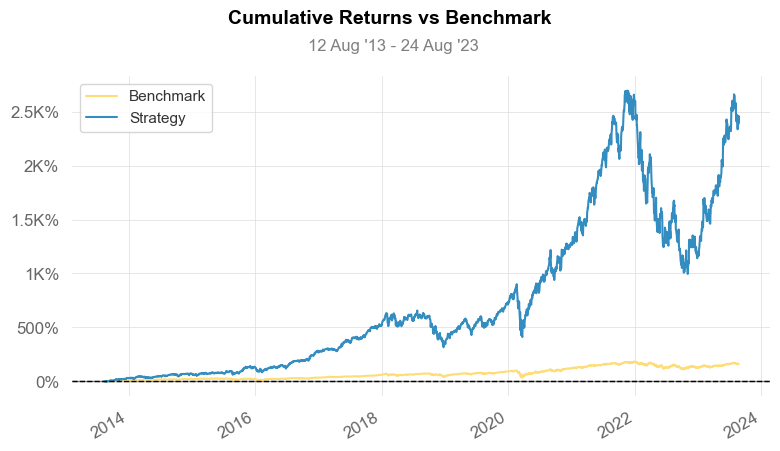

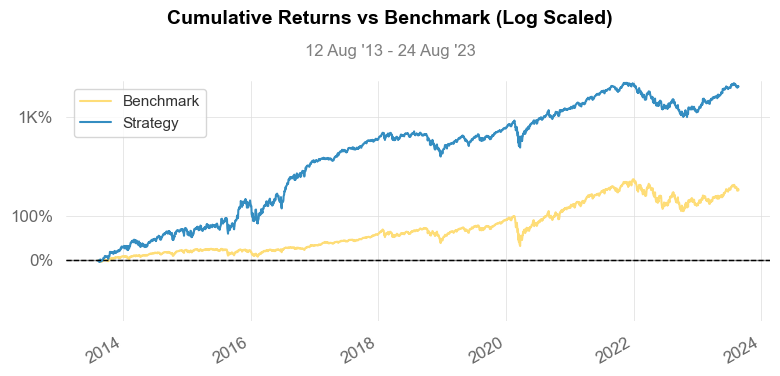

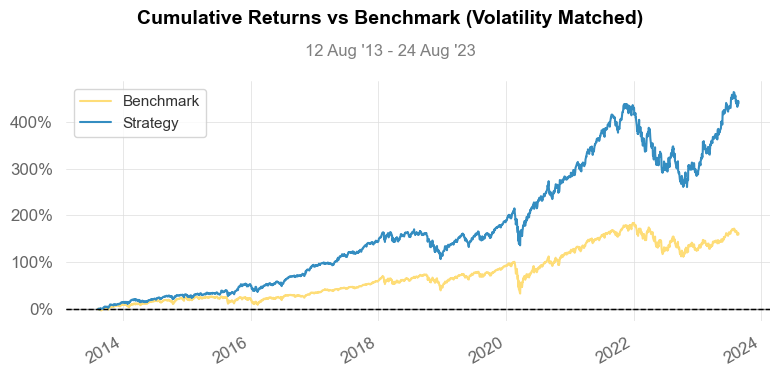

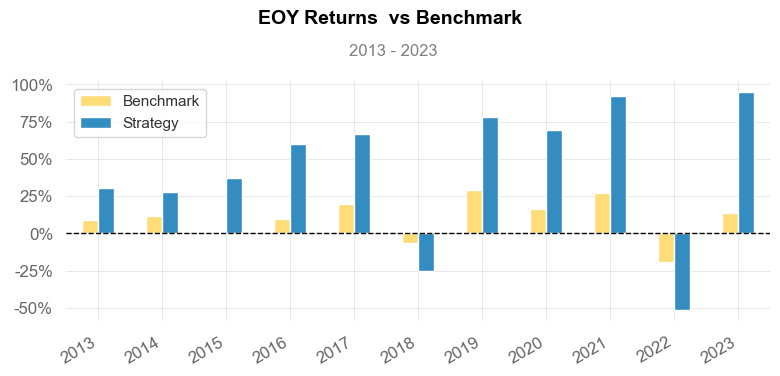

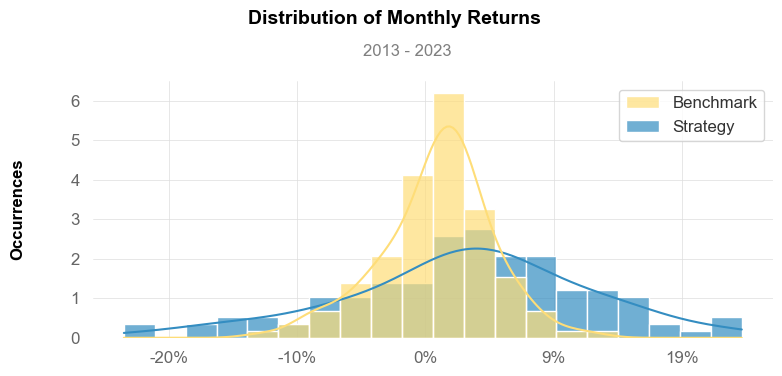

...

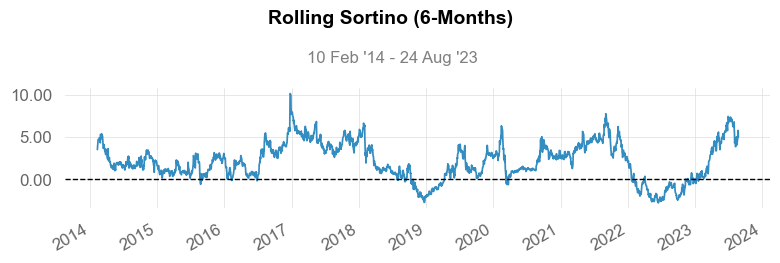

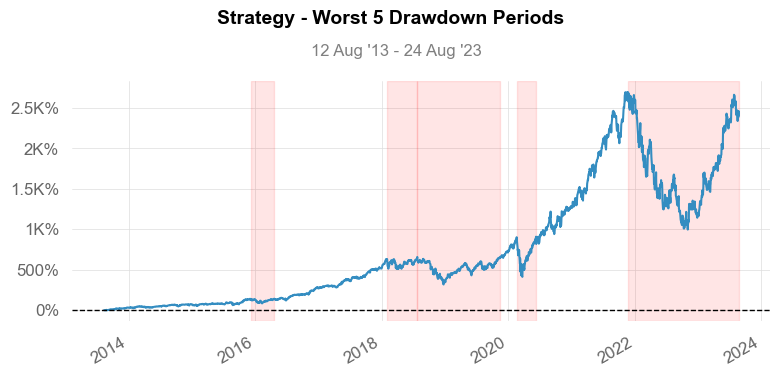

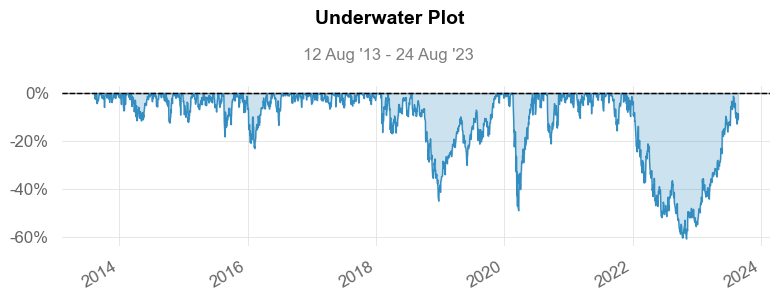

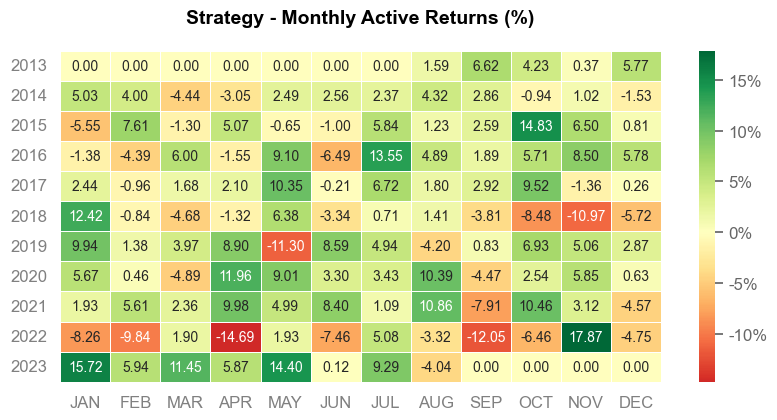

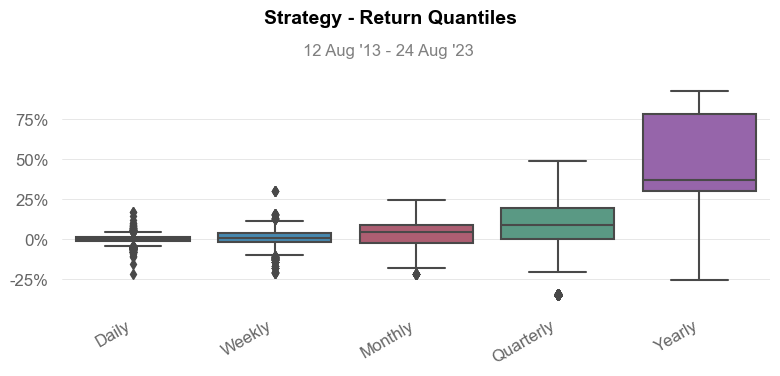

In [26]:
# Generating report on portfolio performance from August 11th, 2013 to August 12th, 2023
qs.reports.full(portfolio, benchmark = sp500)

## Optimizing Portfolio

In [27]:
# Getting dataframes info for Stocks using yfinance
nvda_df = yf.download('NVDA', start = '2013-08-11', end = '2023-08-24')
meta_df = yf.download('META', start = '2013-08-11', end = '2023-08-24')
msft_df = yf.download('MSFT', start = '2013-08-11', end = '2023-08-24')
blk_df = yf.download('BLK', start = '2013-08-11', end = '2023-08-24')
gs_df = yf.download('GS', start = '2013-08-11', end = '2023-08-24')
googl_df = yf.download('GOOGL', start = '2013-08-11', end = '2023-08-24')

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


In [28]:
# Extracting Adjusted Close for each stock
nvda_df = nvda_df['Adj Close']
meta_df = meta_df['Adj Close']
msft_df = msft_df['Adj Close']
blk_df = blk_df['Adj Close']
gs_df = gs_df['Adj Close']
googl_df = googl_df['Adj Close']


In [29]:
# Merging and creating an Adj Close dataframe for stocks
df = pd.concat([nvda_df, meta_df, msft_df, blk_df, gs_df, googl_df], join = 'outer', axis = 1)
df.columns = ['nvda', 'meta', 'msft', 'blk', 'gs', 'googl']
df.head()

,nvda,meta,msft,blk,gs,googl
Date,,,,,,
2013-08-12,3.354695,38.220001,27.333216,216.239914,135.500320,22.159910
2013-08-13,3.366368,37.020000,26.989874,217.483490,137.193176,22.053303
2013-08-14,3.508774,36.650002,27.090359,215.548111,136.883102,21.767017
2013-08-15,3.532119,36.560001,26.621414,209.928604,134.712555,21.513014
2013-08-16,3.546125,37.080002,26.629784,209.975204,134.637177,21.444195


## Markowitz Mean-Variance Optimization Model

`mu` captures the expected annualized returns of the stocks based on Exponentially Weighted Moving Average (EWMA).

`S` captures the sample covariance matrix of the stocks, representing how the returns of two different stocks move together.

In [30]:
from pypfopt.efficient_frontier import EfficientFrontier
from pypfopt import risk_models
from pypfopt import expected_returns

# calculating the annualized expected returns and the annualized sample covariance matrix
mu = expected_returns.ema_historical_return(df)
S = risk_models.sample_cov(df)

In [31]:
# visualizing annualized experected returns
mu

nvda     1.519153
meta     0.573308
msft     0.270653
blk      0.050156
gs       0.041901
googl    0.286030
Name: 2023-08-23 00:00:00, dtype: float64

The `mu` output shows the annualized expected returns for each of the stocks. For instance, NVDA has the highest expected return of approximately 151.92% and GS has one of the lowest at about 4.19%.

In [32]:
# visualizing the covariance matrix
S

,nvda,meta,msft,blk,gs,googl
nvda,0.212277,0.081815,0.075052,0.062599,0.052882,0.069011
meta,0.081815,0.142834,0.056648,0.044673,0.039568,0.066735
msft,0.075052,0.056648,0.074044,0.044567,0.037331,0.052859
blk,0.062599,0.044673,0.044567,0.074488,0.052454,0.041887
gs,0.052882,0.039568,0.037331,0.052454,0.078478,0.036811
googl,0.069011,0.066735,0.052859,0.041887,0.036811,0.077536


The `S` output shows the covariance matrix. Each value represents the covariance between the returns of two stocks. The diagonal values (like 0.212277 for NVDA) represent the variance of the stock's returns.

In [33]:
# Optimizing for maximal sharpe ratio
ef = EfficientFrontier(mu, S) 
weights = ef.max_sharpe()
clean_weights = ef.clean_weights()

# prioritizing optimized weights and expected performance for portfolio
clean_weights

OrderedDict([('nvda', 1.0),
             ('meta', 0.0),
             ('msft', 0.0),
             ('blk', 0.0),
             ('gs', 0.0),
             ('googl', 0.0)])

The clean_weights output shows the optimized weights for the portfolio. Here, it suggests to invest 100% in NVDA and 0% in all other stocks to achieve the highest Sharpe Ratio.

In [34]:
#Creating new portfolio with optimized wieghts
new_weights = [1.0]
optimized_portfolio = nvda*new_weights[0]
optimized_portfolio #visualizing daily returns

Date
2013-08-12   -0.008282
2013-08-13    0.003479
2013-08-14    0.042302
2013-08-15    0.006653
2013-08-16    0.003966
                ...   
2023-08-18   -0.001038
2023-08-21    0.084713
2023-08-22   -0.027658
2023-08-23    0.031707
2023-08-24    0.000998
Name: Close, Length: 2527, dtype: float64

The optimized_portfolio output shows the daily returns of a portfolio consisting solely of NVDA for the given date range.

                           Benchmark    Strategy
-------------------------  -----------  ----------
Start Period               2013-08-12   2013-08-12
End Period                 2023-08-24   2023-08-24
Risk-Free Rate             0.0%         0.0%
Time in Market             100.0%       100.0%

Cumulative Return          2,410.87%    12,919.46%
CAGR﹪                     24.82%       39.78%

Sharpe                     1.04         1.28
Prob. Sharpe Ratio         99.94%       100.0%
Smart Sharpe               0.97         1.2
Sortino                    1.49         2.0
Smart Sortino              1.4          1.87
Sortino/√2                 1.06         1.42
Smart Sortino/√2           0.99         1.32
Omega                      1.27         1.27

Max Drawdown               -60.82%      -66.36%
Longest DD Days            641          541
Volatility (ann.)          37.83%       46.06%
R^2                        0.63         0.63
Information Ratio          0.04         0.04
Calmar           

None

,Start,Valley,End,Days,Max Drawdown,99% Max Drawdown
1,2021-11-30,2022-10-14,2023-05-24,541,-66.362059,-64.381593
2,2018-10-02,2018-12-24,2020-02-13,500,-56.082386,-54.520316
3,2020-02-20,2020-03-16,2020-05-08,79,-37.591361,-35.551319
4,2015-12-07,2016-02-08,2016-03-17,102,-25.274076,-25.037039
5,2021-02-17,2021-03-08,2021-04-12,55,-24.376642,-19.308234


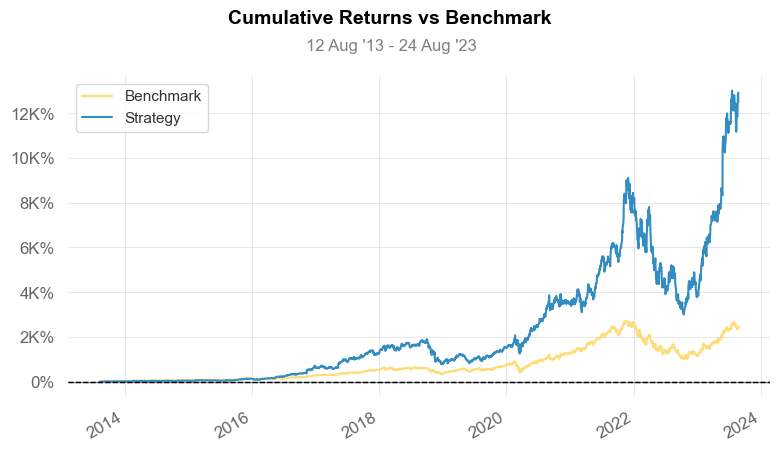

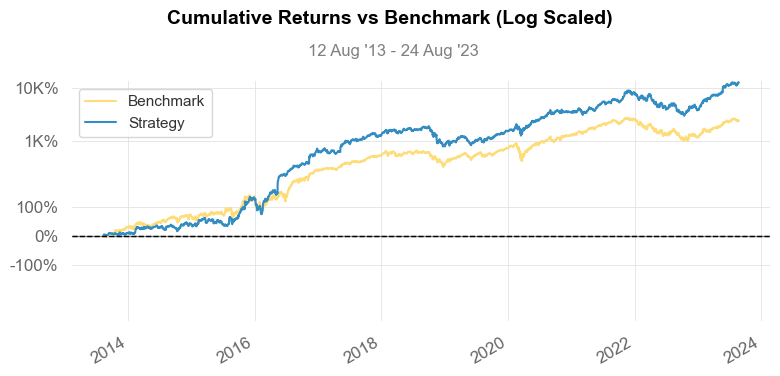

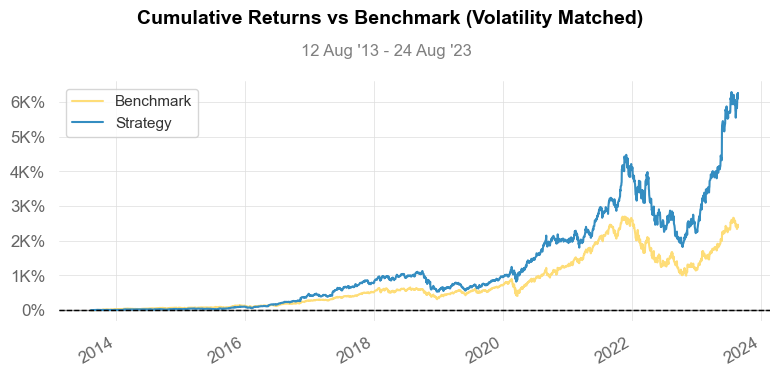

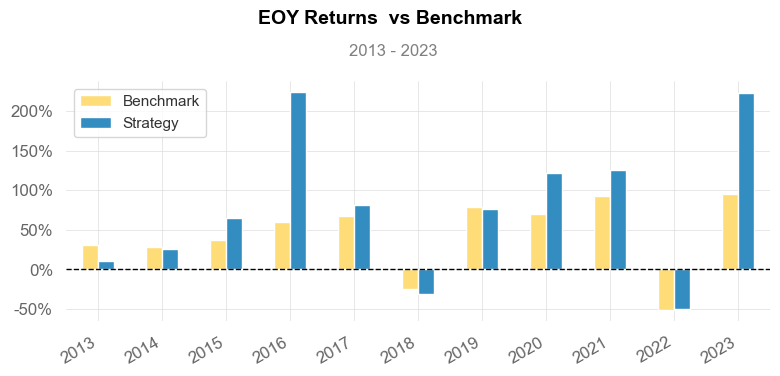

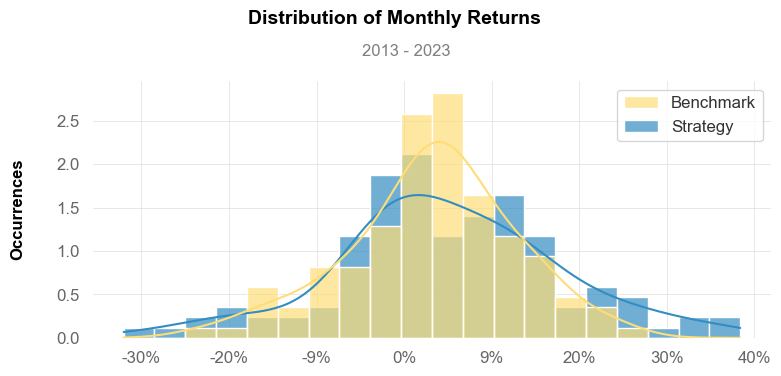

...

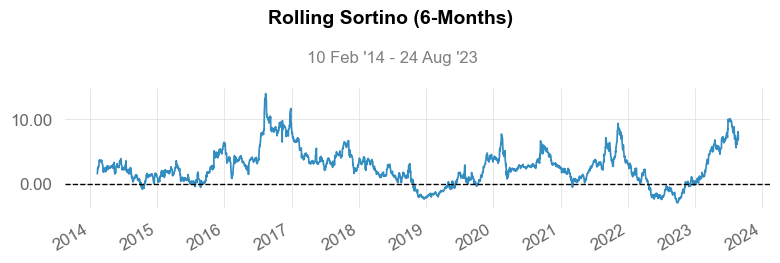

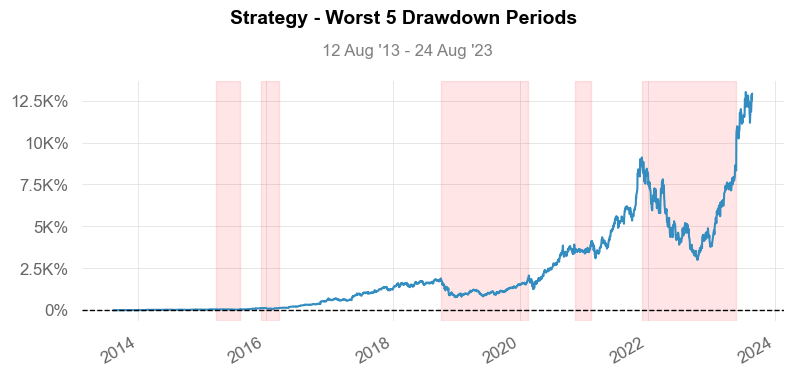

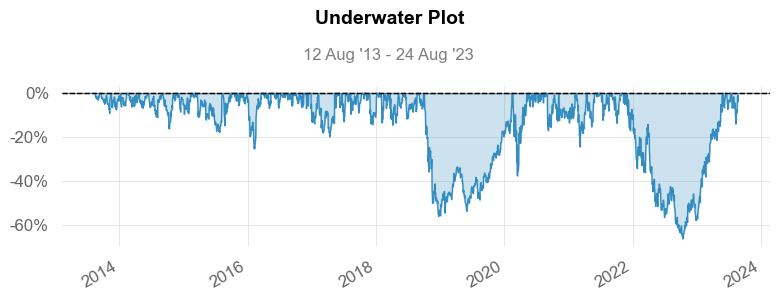

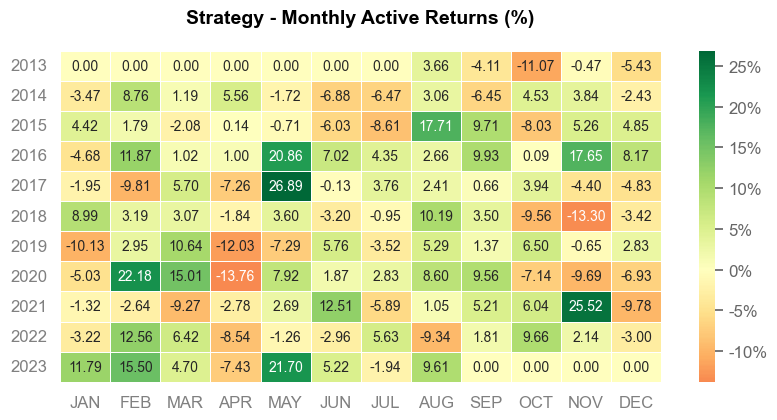

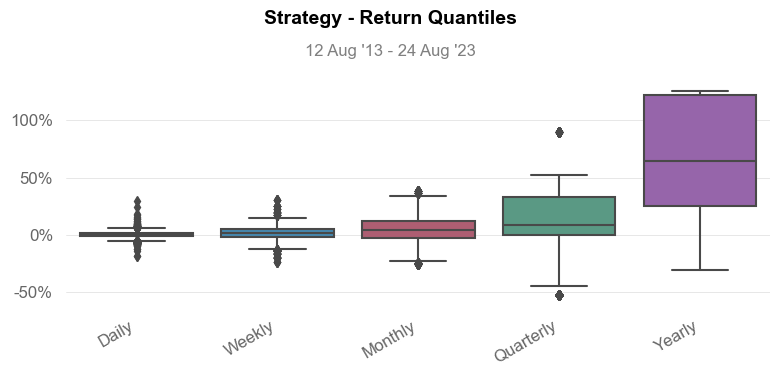

In [35]:
# Displaying new reports comparing the optimized portfolio to the first portfolio constructed
qs.reports.full(optimized_portfolio, benchmark = portfolio)

Cumulative Return: The optimized_portfolio outperformed the benchmark with a return of 12,919.46% compared to the benchmark's 2,410.87%.

CAGR (Compound Annual Growth Rate): The annualized return of the optimized_portfolio is 39.78% compared to the benchmark's 24.82%.

Sharpe Ratio: Measures the risk-adjusted return. The optimized portfolio has a Sharpe of 1.28, indicating higher risk-adjusted returns than the benchmark's 1.04.

Max Drawdown: Indicates the largest drop in portfolio value. The optimized portfolio has a higher drawdown (-66.36%) compared to the benchmark (-60.82%), suggesting it might be riskier.

Volatility: The annualized standard deviation of returns. The optimized portfolio is more volatile (46.06%) than the benchmark (37.83%).

Beta: Measures the sensitivity of the portfolio's returns to the benchmark's returns. A beta of 0.97 for the optimized portfolio suggests it moves closely with the benchmark.

Alpha: Indicates the excess return of the portfolio compared to the benchmark after adjusting for risk (beta). An alpha of 0.21 indicates the optimized portfolio outperforms by 21% on a risk-adjusted basis.

Correlation: The optimized_portfolio has a 79.42% correlation with the benchmark, indicating a strong linear relationship between their returns.

Treynor Ratio: Measures returns earned in excess of that which could've been earned on a riskless investment per each unit of market risk. The optimized portfolio has a higher Treynor Ratio, suggesting better risk-adjusted performance.

## Black-Litterman Allocation Model

In [36]:
# List of ticker symbols
assets = ['NVDA', 'META', 'MSFT', 'BLK', 'GS', 'GOOGL']

# Download data for the tickers
data = yf.download(assets, start="2013-08-11", end="2023-08-24", progress=False)

# Store market caps in a pandas Series
market_caps = pd.Series(dtype=float)

for ticker in assets:
    market_cap = data['Close'][ticker][-1] * data['Volume'][ticker][-1]
    market_caps[ticker] = market_cap
    print(f"Market Cap for {ticker}: {market_cap}")


Market Cap for NVDA: 36705531621.295166
Market Cap for META: 5380766701.416016
Market Cap for MSFT: 6921412800.0
Market Cap for BLK: 262548243.5546875
Market Cap for GS: 460609550.8117676
Market Cap for GOOGL: 3682493553.161621


In [37]:
# Obtaining closing prices for the SP500
market_prices = yf.download("^GSPC",start = '2013-08-11', end = '2023-08-24')['Adj Close']


[*********************100%%**********************]  1 of 1 completed


Delta represents the market-implied risk aversion. It's a measure that indicates how much the market dislikes risk. A higher delta means the market is more risk-averse.

In [38]:
# Obtaining market-implied risk aversion, the delta
delta = black_litterman.market_implied_risk_aversion(market_prices)
delta # Visualizing delta

2.9472884795705996

here the delta value implies a moderate level of risk aversion in the market.

In [39]:
# Get the daily returns of the assets
daily_returns = expected_returns.returns_from_prices(data['Close'])
daily_returns.head()

,BLK,GOOGL,GS,META,MSFT,NVDA
Date,,,,,,
2013-08-13,0.005751,-0.004811,0.012493,-0.031397,-0.019471,0.003479
2013-08-14,-0.008899,-0.012982,-0.002260,-0.009995,0.003723,0.042302
2013-08-15,-0.026071,-0.011669,-0.015856,-0.002456,-0.017311,0.006653
2013-08-16,0.000222,-0.003199,-0.000560,0.014223,0.000315,0.003966
2013-08-19,-0.012623,0.010199,-0.012635,0.019687,-0.012893,-0.015800


This matrix measures the degree to which the returns of two assets vary together. A higher covariance indicates that the asset returns move together, whereas a lower or negative value indicates they move inversely.

In [40]:
S

,nvda,meta,msft,blk,gs,googl
nvda,0.212277,0.081815,0.075052,0.062599,0.052882,0.069011
meta,0.081815,0.142834,0.056648,0.044673,0.039568,0.066735
msft,0.075052,0.056648,0.074044,0.044567,0.037331,0.052859
blk,0.062599,0.044673,0.044567,0.074488,0.052454,0.041887
gs,0.052882,0.039568,0.037331,0.052454,0.078478,0.036811
googl,0.069011,0.066735,0.052859,0.041887,0.036811,0.077536


take nvda as an example, since it is the highest, NVIDIA's returns have a covariance of 0.212277 with themselves (variance), which is expected for any asset with itself.

Given the market capitalization and the delta, the market-implied prior returns represent the expected returns based on the equilibrium market conditions.

In [41]:
# Convert the index of market_caps to lowercase
market_caps.index = market_caps.index.str.lower()

# Try calculating the prior again
prior = black_litterman.market_implied_prior_returns(market_caps, delta, S)
print(prior)


nvda     0.519167
meta     0.264962
msft     0.229441
blk      0.187994
gs       0.163346
googl    0.217072
dtype: float64


The maximum prior is NVDIA, 0.519167 means that the market expects NVIDIA to return about 51.92% based on the current market conditions and data.

In [42]:
# NVDIA will raise by 15%
# META will raise by 10%
# Google will outperform Microsoft by 15%
# Goldman Sachs will outperform BlackRock by 5%

Q = np.array([0.15, 0.10, 0.15, 0.05])

In [43]:
# Linking views to assets
P = np.array([
    [1, 0, 0, 0, 0, 0],   # NVDIA
    [0, 1, 0, 0, 0, 0],   # META
    [0, 0, -1, 0, 0, 1],  # Google outperforms Microsoft
    [0, 0, 0, -1, 1, 0]   # Goldman Sachs outperforms BlackRock
])


In [44]:
# Providing confidence levels
# Closer to 0.0 = Low confidence
# Closer to 1.0 = High confidence
confidences = [0.5, 0.4, 0.8, 0.6]  # Corrected to match number of views


In [45]:
# Creating model
bl = BlackLittermanModel(S, # Covariance Matrix
                         pi = prior, # Prior expected returns
                         Q = Q, # Vector of views
                         P = P, # Matrix mapping the views
                         omega = 'idzorek', # Method to estimate uncertainty level of the views based on historical data
                         view_confidences = confidences) # Confidences

In [46]:
rets = bl.bl_returns() # Calculating Expected returns
ef = EfficientFrontier(rets, S) # Optimizing asset allocation

In [47]:
ef.max_sharpe() # Optimizing weights for maximal Sharpe ratio
weights = ef.clean_weights() # Cleaning weights
weights # Printing weights

OrderedDict([('nvda', 0.31694),
             ('meta', 0.0),
             ('msft', 0.0),
             ('blk', 0.0),
             ('gs', 0.01899),
             ('googl', 0.66407)])

suggest that to maximize the Sharpe ratio (a measure of risk-adjusted return), the portfolio should allocate roughly 31.69% to NVIDIA and 66.41% to Google.

In [48]:
# Building Black-Litterman portfolio
black_litterman_weights = [0.31693,
                          0,
                          0,
                          0,
                          0.01899,
                          0.66407]
black_litterman_portfolio = nvda*black_litterman_weights[0] + meta*black_litterman_weights[1] + msft*black_litterman_weights[2] + blk*black_litterman_weights[3] + gs*black_litterman_weights[4] + googl*black_litterman_weights[5]

In [49]:
# Black-Litterman Portfolio daily returns
black_litterman_portfolio

Date
2013-08-12   -0.006331
2013-08-13   -0.001855
2013-08-14    0.004743
2013-08-15   -0.005942
2013-08-16   -0.000878
                ...   
2023-08-18   -0.013053
2023-08-21    0.031422
2023-08-22   -0.005285
2023-08-23    0.027186
2023-08-24   -0.012817
Name: Close, Length: 2527, dtype: float64

                           Benchmark    Strategy
-------------------------  -----------  ----------
Start Period               2013-08-12   2013-08-12
End Period                 2023-08-24   2023-08-24
Risk-Free Rate             0.0%         0.0%
Time in Market             100.0%       100.0%

Cumulative Return          2,410.87%    1,703.69%
CAGR﹪                     24.82%       22.01%

Sharpe                     1.04         1.13
Prob. Sharpe Ratio         99.94%       99.98%
Smart Sharpe               0.96         1.04
Sortino                    1.49         1.67
Smart Sortino              1.37         1.53
Sortino/√2                 1.06         1.18
Smart Sortino/√2           0.97         1.08
Omega                      1.23         1.23

Max Drawdown               -60.82%      -47.94%
Longest DD Days            641          570
Volatility (ann.)          37.83%       29.34%
R^2                        0.85         0.85
Information Ratio          -0.03        -0.03
Calmar         

None

,Start,Valley,End,Days,Max Drawdown,99% Max Drawdown
1,2021-11-22,2022-11-03,2023-06-14,570,-47.935099,-45.837807
2,2018-08-30,2018-12-24,2019-12-13,471,-33.781342,-29.990253
3,2020-02-20,2020-03-16,2020-05-28,99,-32.235540,-31.522549
4,2020-09-03,2020-09-23,2020-11-03,62,-16.935417,-15.845098
5,2015-12-30,2016-02-08,2016-03-31,93,-15.914682,-15.889078


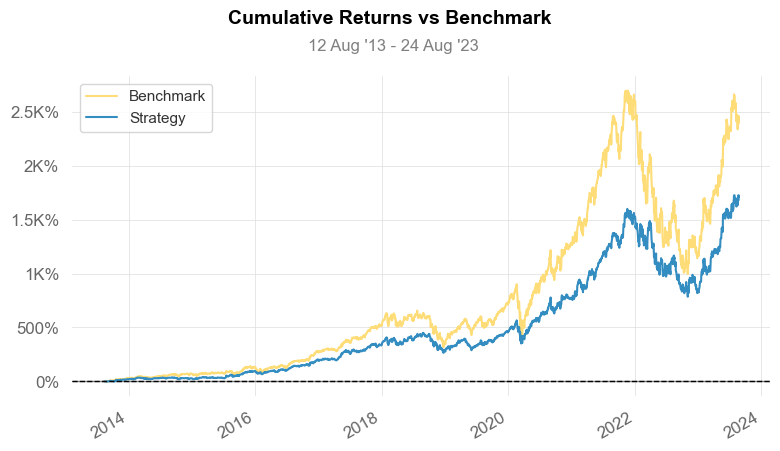

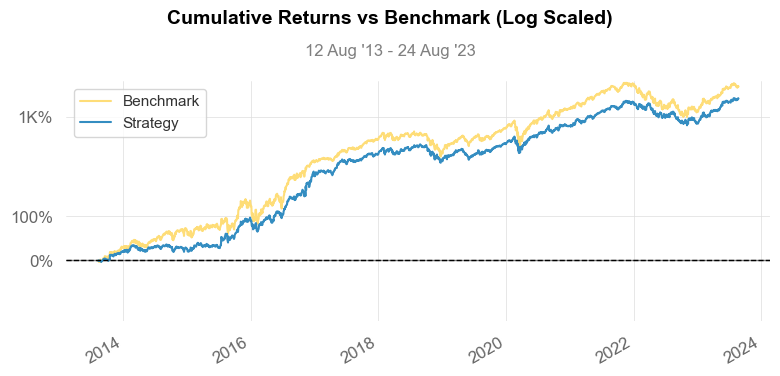

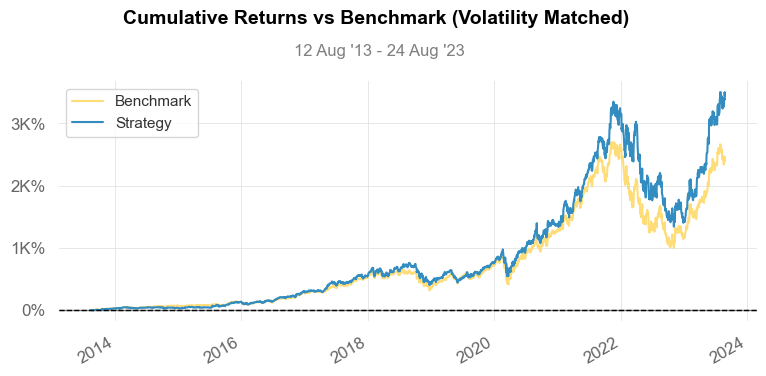

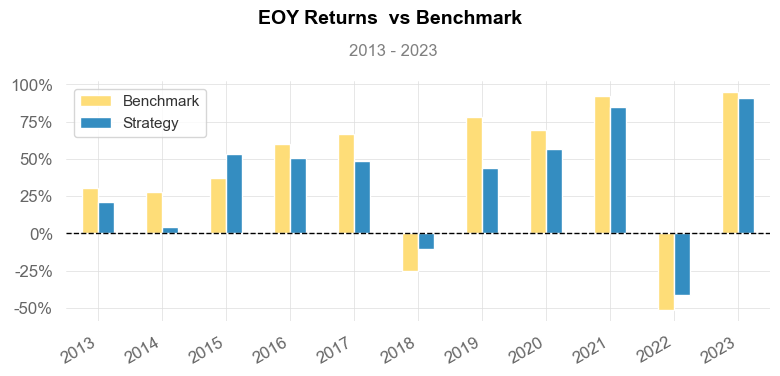

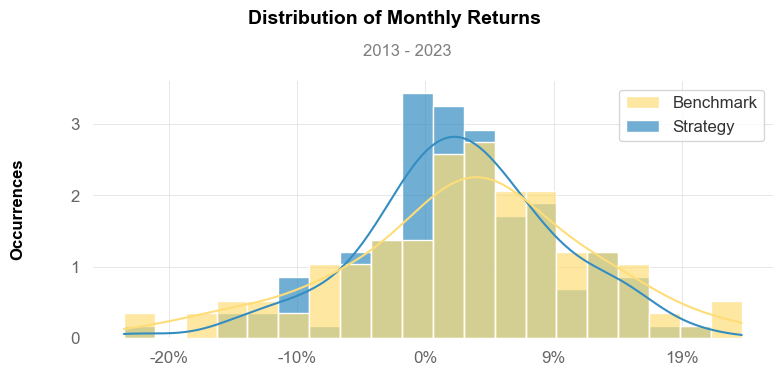

...

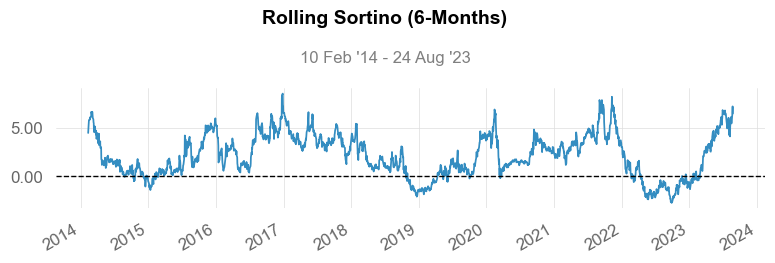

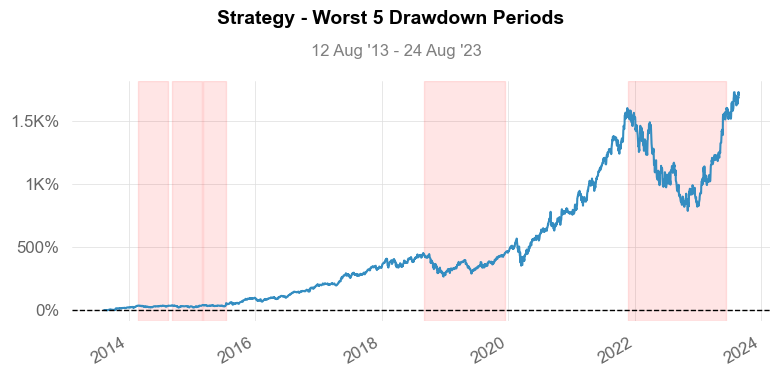

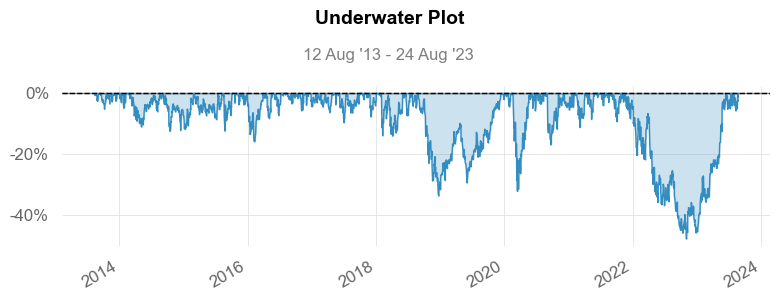

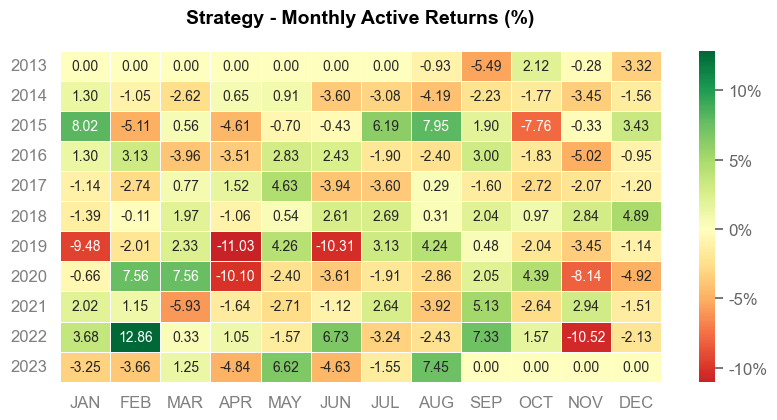

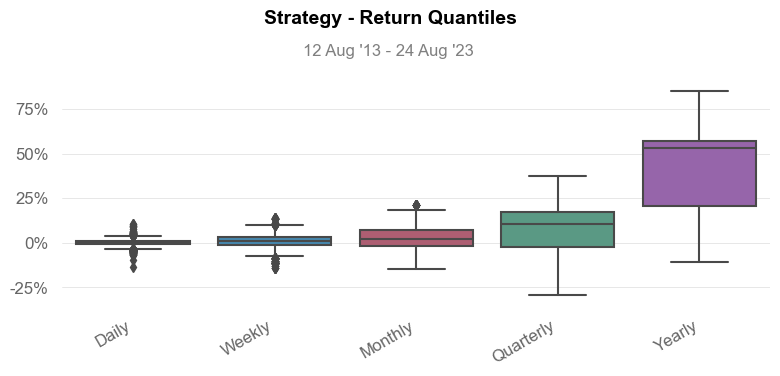

In [50]:
# Comparing Black-Litterman portfolio to the original portfolio
qs.reports.full(black_litterman_portfolio, benchmark = portfolio)

When comparing the Black-Litterman portfolio to the original portfolio:

Cumulative Return: The strategy yielded a return of 1,703.69%, while the benchmark yielded 2,410.87%. Although the Black-Litterman strategy underperformed in terms of raw returns, it's essential to consider other risk metrics.

Sharpe Ratio: The strategy has a Sharpe ratio of 1.13 compared to the benchmark's 1.04, indicating the strategy provided a better risk-adjusted return.

Max Drawdown: The strategy had a max drawdown (maximum loss from peak to trough) of 47.94%, which is less severe than the benchmark's 60.82%. This suggests that the Black-Litterman strategy might be less volatile or risky.

## Fundamental vs. Technical Analysis

In [51]:
# Downloading NVIDIA Stocks
nvda = yf.download('NVDA', start = '2013-08-01', end = '2023-08-24')

[*********************100%%**********************]  1 of 1 completed


In [52]:
nvda # Displaying data


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2013-08-01,3.622500,3.667500,3.580000,3.660000,3.417728,27764800
2013-08-02,3.652500,3.697500,3.627500,3.690000,3.445742,20962800
2013-08-05,3.680000,3.720000,3.660000,3.707500,3.462083,18518800
2013-08-06,3.710000,3.717500,3.645000,3.652500,3.410724,20660800
2013-08-07,3.632500,3.687500,3.630000,3.650000,3.408390,24438000
...,...,...,...,...,...,...
2023-08-17,439.700012,440.619995,430.010010,433.440002,433.440002,45239500
2023-08-18,426.350006,435.779999,416.600006,432.989990,432.989990,58262200
2023-08-21,444.940002,470.649994,442.220001,469.670013,469.670013,69257300


In [53]:
nvda.dtypes # Printing data types

Open         float64
High         float64
Low          float64
Close        float64
Adj Close    float64
Volume         int64
dtype: object

### NVDA Candlestick Chart Analysis (From Aug 11th, 2013 to Aug 24th, 2023)

The goal of this analysis is to visualize NVIDIA's (NVDA) stock price movements over a decade using a candlestick chart, along with its trading volume. A candlestick chart provides a comprehensive view of price movements by representing four key levels for a time period: opening price, closing price, the highest price, and the lowest price.

#### Methodology
Candlestick Chart: The primary chart showcases NVDA's price movements.

* The "wicks" of the candle represent the highest and lowest prices during the chosen period.

* The "body" of the candle represents the opening and closing prices. If the closing price is higher than the opening price, the body is usually colored differently (e.g., green) than when the opening price is higher than the closing price (e.g., red).

Volume Chart: Situated below the candlestick chart, this bar chart indicates the number of shares traded during the period. The height of the bar corresponds to the volume of shares traded.

In [54]:
import nbformat

# Plotting candlestick chart without indicators
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.05, row_heights = [0.7, 0.3])
fig.add_trace(go.Candlestick(x=nvda.index,
                             open=nvda['Open'],
                             high=nvda['High'],
                             low=nvda['Low'],
                             close=nvda['Adj Close'],
                             name='NVDA'),
              row=1, col=1)


# Plotting volume chart on the second row 
fig.add_trace(go.Bar(x=nvda.index,
                     y=nvda['Volume'],
                     name='Volume',
                     marker=dict(color='orange', opacity=1.0)),
              row=2, col=1)

# Plotting annotation
fig.add_annotation(text='NVDIA (NVDA)',
                    font=dict(color='white', size=40),
                    xref='paper', yref='paper',
                    x=0.5, y=0.65,
                    showarrow=False,
                    opacity=0.2)

# Configuring layout
fig.update_layout(title='NVDA Candlestick Chart From Aug 11th, 2013 to Aug 24th, 2023',
                  yaxis=dict(title='Price (USD)'),
                  height=1000,
                 template = 'plotly_dark')

# Configuring axes and subplots
fig.update_xaxes(rangeslider_visible=False, row=1, col=1)
fig.update_xaxes(rangeslider_visible=False, row=2, col=1)
fig.update_yaxes(title_text='Price (USD)', row=1, col=1)
fig.update_yaxes(title_text='Volume', row=2, col=1)

fig.show()

For Candlestick Chart, Observing the chart, NVIDIA's stock price appears to have had multiple fluctuations throughout the decade. Most notably, a significant price surge is visible at the end of 2022. This sharp increase could be attributed to various factors, including product launches, quarterly results, or strategic announcements. In our scenario, this is thanks to advancements in AI, which NVIDIA is a significant player in. Such surges are particularly important for investors and traders, as they can signify strong market confidence in the company's future prospects.

For Volume chart, The bars indicate the volume of shares traded. A higher volume, especially during price surges or drops, indicates strong investor interest and can be used to validate the price movement. In this case, NVIDIA has been maintain pretty stable in the large sclae, maintaining at arounf 100M.

### NVDA Stock Analysis with Technical Indicators (From July 1st, 2010 to February 10th, 2023)

In this analysis, we've expanded our visualizations by integrating key technical indicators alongside NVIDIA's (NVDA) stock price movement. Technical indicators assist investors in making informed decisions based on historical data.

#### Methodology

Moving Averages (MA): These smooth out price data to create a single flowing line, making it easier to identify the direction of the trend.

* Exponential Moving Average (EMA9): Places more weight on recent data points.

* Simple Moving Averages (SMA): Includes SMA20, SMA50, SMA100, and SMA200, each representing different periods.

Bollinger Bands: Helps in understanding price volatility. A price movement towards the upper band may indicate an overbought condition, while a move towards the lower band may signal an oversold state.

Relative Strength Index (RSI): Ranges from 0 to 100 and helps determine if a stock is overbought or oversold. Typically, RSI above 70 suggests overbought, while below 30 suggests oversold.

Average True Range (ATR): Indicates market volatility. Higher ATR values mean price moves are large and volatility is high, and vice versa.

Volume: The number of shares traded.

In [55]:
# Adding Moving Averages
nvda['EMA9'] = nvda['Adj Close'].ewm(span = 9, adjust = False).mean() # Exponential 9-Period Moving Average
nvda['SMA20'] = nvda['Adj Close'].rolling(window=20).mean() # Simple 20-Period Moving Average
nvda['SMA50'] = nvda['Adj Close'].rolling(window=50).mean() # Simple 50-Period Moving Average
nvda['SMA100'] = nvda['Adj Close'].rolling(window=100).mean() # Simple 100-Period Moving Average
nvda['SMA200'] = nvda['Adj Close'].rolling(window=200).mean() # Simple 200-Period Moving Average

# Adding RSI for 14-periods 
delta = nvda['Adj Close'].diff() # Calculating delta
gain = delta.where(delta > 0,0) # Obtaining gain values
loss = -delta.where(delta < 0,0) # Obtaining loss values
avg_gain = gain.rolling(window=14).mean() # Measuring the 14-period average gain value
avg_loss = loss.rolling(window=14).mean() # Measuring the 14-period average loss value
rs = avg_gain/avg_loss # Calculating the RS
nvda['RSI'] = 100 - (100 / (1 + rs)) # Creating an RSI column to the Data Frame 

# Adding Bollinger Bands 20-periods
nvda['BB_UPPER'] = nvda['SMA20'] + 2*nvda['Adj Close'].rolling(window=20).std() # Upper Band
nvda['BB_LOWER'] = nvda['SMA20'] - 2*nvda['Adj Close'].rolling(window=20).std() # Lower Band

# Adding ATR 14-periods
nvda['TR'] = pd.DataFrame(np.maximum(np.maximum(nvda['High'] - nvda['Low'], abs(nvda['High'] - nvda['Adj Close'].shift())), abs(nvda['Low'] - nvda['Adj Close'].shift())), index = nvda.index)
nvda['ATR'] = nvda['TR'].rolling(window = 14).mean() # Creating an ART column to the Data Frame 

In [56]:
nvda.tail(50) # Plotting last 50 trading days with indicators

,Open,High,Low,Close,Adj Close,Volume,EMA9,SMA20,SMA50,SMA100,SMA200,RSI,BB_UPPER,BB_LOWER,TR,ATR
Date,,,,,,,,,,,,,,,,
2023-06-13,401.859985,411.010010,397.399994,410.220001,410.220001,61320800,388.003274,360.866260,310.225139,270.166041,207.758931,76.140363,444.345927,277.386592,16.190002,21.225625
2023-06-14,408.239990,430.000000,405.519989,429.970001,429.970001,74046500,396.396620,367.759772,313.232117,272.682328,209.096453,78.850980,450.091765,285.427778,24.480011,22.346466
2023-06-15,426.019989,432.890015,421.470001,426.529999,426.529999,56862200,402.423295,373.998833,316.272686,275.028853,210.439705,66.127090,454.151473,293.846192,11.420013,16.772784
2023-06-16,434.500000,437.209991,426.609985,426.920013,426.920013,65475500,407.322639,379.507472,319.435442,277.372080,211.801544,63.813971,458.223644,300.791300,10.679993,16.378496
2023-06-20,429.980011,439.899994,426.739990,438.079987,438.079987,45115300,413.474109,385.781088,322.790201,279.821107,213.237867,63.683179,462.008048,309.554128,13.160004,15.178473
2023-06-21,435.010010,436.149994,420.799988,430.450012,430.450012,55160300,416.869289,391.717201,325.883972,282.145949,214.693843,71.709486,461.915083,321.519319,17.279999,14.646330
2023-06-22,422.529999,434.260010,422.339996,430.250000,430.250000,41773700,419.545431,397.887289,329.055734,284.412505,216.163306,66.142395,457.583737,338.190842,11.920013,13.912105
2023-06-23,424.640015,428.089996,420.149994,422.089996,422.089996,35632300,420.054344,403.724368,332.199082,286.717729,217.601062,63.785290,445.446032,362.002705,10.100006,13.603533
2023-06-26,424.609985,427.640015,401.000000,406.320007,406.320007,59432200,417.307477,405.052335,335.033430,288.827763,218.947325,56.161415,445.224388,364.880281,26.640015,14.893535


In [57]:
# Plotting Candlestick charts with indicators
fig = make_subplots(rows=4, cols=1, shared_xaxes=True, vertical_spacing=0.05,row_heights=[0.6, 0.10, 0.10, 0.20])

# Candlestick 
fig.add_trace(go.Candlestick(x=nvda.index,
                             open=nvda['Open'],
                             high=nvda['High'],
                             low=nvda['Low'],
                             close=nvda['Adj Close'],
                             name='NVDA'),
              row=1, col=1)

# Moving Averages
fig.add_trace(go.Scatter(x=nvda.index,
                         y=nvda['EMA9'],
                         mode='lines',
                         line=dict(color='#90EE90'),
                         name='EMA9'),
              row=1, col=1)

fig.add_trace(go.Scatter(x=nvda.index,
                         y=nvda['SMA20'],
                         mode='lines',
                         line=dict(color='yellow'),
                         name='SMA20'),
              row=1, col=1)

fig.add_trace(go.Scatter(x=nvda.index,
                         y=nvda['SMA50'],
                         mode='lines',
                         line=dict(color='orange'),
                         name='SMA50'),
              row=1, col=1)

fig.add_trace(go.Scatter(x=nvda.index,
                         y=nvda['SMA100'],
                         mode='lines',
                         line=dict(color='purple'),
                         name='SMA100'),
              row=1, col=1)
fig.add_trace(go.Scatter(x=nvda.index,
                         y=nvda['SMA200'],
                         mode='lines',
                         line=dict(color='red'),
                         name='SMA200'),
              row=1, col=1)

# Bollinger Bands
fig.add_trace(go.Scatter(x=nvda.index,
                         y=nvda['BB_UPPER'],
                         mode='lines',
                         line=dict(color='#00BFFF'),
                         name='Upper Band'),
              row=1, col=1)

fig.add_trace(go.Scatter(x=nvda.index,
                         y=nvda['BB_LOWER'],
                         mode='lines',
                         line=dict(color='#00BFFF'),
                         name='Lower Band'),
              row=1, col=1)

fig.add_annotation(text='NVIDIA (NVDA)',
                    font=dict(color='white', size=40),
                    xref='paper', yref='paper',
                    x=0.5, y=0.65,
                    showarrow=False,
                    opacity=0.2)

# Relative Strengh Index (RSI)
fig.add_trace(go.Scatter(x=nvda.index,
                         y=nvda['RSI'],
                         mode='lines',
                         line=dict(color='#CBC3E3'),
                         name='RSI'),
              row=2, col=1)

# Adding marking lines at 70 and 30 levels
fig.add_shape(type="line",
              x0=nvda.index[0], y0=70, x1=nvda.index[-1], y1=70,
              line=dict(color="red", width=2, dash="dot"),
              row=2, col=1)
fig.add_shape(type="line",
              x0=nvda.index[0], y0=30, x1=nvda.index[-1], y1=30,
              line=dict(color="#90EE90", width=2, dash="dot"),
              row=2, col=1)

# Average True Range (ATR)
fig.add_trace(go.Scatter(x=nvda.index,
                         y=nvda['ATR'],
                         mode='lines',
                         line=dict(color='#00BFFF'),
                         name='ATR'),
              row=3, col=1)

# Volume
fig.add_trace(go.Bar(x=nvda.index,
                     y=nvda['Volume'],
                     name='Volume',
                     marker=dict(color='orange', opacity=1.0)),
              row=4, col=1)

# Layout
fig.update_layout(title='NVDA Candlestick Chart From July 1st, 2010 to February 10th, 2023',
                  yaxis=dict(title='Price (USD)'),
                  height=1000,
                 template = 'plotly_dark')

# Axes and subplots
fig.update_xaxes(rangeslider_visible=False, row=1, col=1)
fig.update_xaxes(rangeslider_visible=False, row=4, col=1)
fig.update_yaxes(title_text='Price (USD)', row=1, col=1)
fig.update_yaxes(title_text='RSI', row=2, col=1)
fig.update_yaxes(title_text='ATR', row=3, col=1)
fig.update_yaxes(title_text='Volume', row=4, col=1)

fig.show()


Candlestick and Price Indicators:

* Price: From the chart, we observe that all moving averages colors have shown significant growth from mid to the end of 2022. This emphasizes the stock's bullish trend during that period.

* Bollinger Bands: A tighter squeeze in the bands can foretell a surge in price volatility. The bands expand and contract based on market volatility.

RSI:

* The RSI chart has fluctuated but importantly, stayed within the 70 and 30 range. This suggests that during this period, the stock wasn't in a consistent overbought or oversold state, making it relatively stable in terms of momentum.

ATR:

* Interestingly, the ATR was nearly zero from 2013 to 2020, indicating minimal volatility. But, post-2020, there's a gradual increase. This means the stock started experiencing more significant price swings, pointing to increased market volatility or perhaps reactions to key events.

Volume:

* The trading volume fluctuated, but when observed from a broader perspective, it maintained around the 100M mark. Volume can validate the strength of price movements. Consistent high volume can indicate a strong consensus among traders about the price direction.

### NVDA and GOOGL Fundamental Indicators

We start by analyzing the fundamental indicators for two tech giants - NVIDIA (NVDA) and Google (GOOGL).

In [58]:
# NVDA indicators (obtained from https://finance.yahoo.com/quote/NVDA/key-statistics?p=NVDA)

nvda_eps = 4.14
nvda_pe_ratio = 46.51
nvda_roe = 40.22
nvda_dy = 0.03

# GOOGL indicators (obtained from https://finance.yahoo.com/quote/GOOGL/key-statistics?p=GOOGL)
googl_eps = 4.73
googl_pe_ratio = 22.88
googl_roe = 23.33
googl_dy = 0.00

# Printing data
print('\n')
print('NVDIA (NVDA) Fundamental Indicators: ')
print('\n')
print('Earnings per Share (EPS): ',nvda_eps)
print('Price-to-Earnings Ratio (P/E): ', nvda_pe_ratio)
print('Return on Equity (ROE): ', nvda_roe,"%")
print('Dividend Yield: ', nvda_dy,"%")
print('\n')
print('GOOGL Fundamental Indicators: ')
print('\n')
print('Earnings per Share (EPS): ',googl_eps)
print('Price-to-Earnings Ratio (P/E): ', googl_pe_ratio)
print('Return on Equity (ROE): ',googl_roe,"%")
print('Dividend Yield: ', googl_dy,"%")
print('\n')



NVDIA (NVDA) Fundamental Indicators: 


Earnings per Share (EPS):  4.14
Price-to-Earnings Ratio (P/E):  46.51
Return on Equity (ROE):  40.22 %
Dividend Yield:  0.03 %


GOOGL Fundamental Indicators: 


Earnings per Share (EPS):  4.73
Price-to-Earnings Ratio (P/E):  22.88
Return on Equity (ROE):  23.33 %
Dividend Yield:  0.0 %




NVDA

Earnings per Share (EPS): 4.14

This means for every share of NVDA owned, the company earned $4.14 over the past year.

Price-to-Earnings Ratio (P/E): 46.51

This indicates that for every dollar of earnings (EPS), investors are willing to pay $46.51. A higher P/E ratio might suggest that the stock is overvalued, or that investors expect high growth rates in the future.

Return on Equity (ROE): 40.22%

This metric provides insight into the profitability of a company. An ROE of 40.22% means that NVDA generated a net income of $40.22 for every $100 of shareholders' equity.

Dividend Yield: 0.03%

This indicates that shareholders receive a 0.03% return on their investment from dividends alone.

GOOGL

Earnings per Share (EPS): 4.73

For every share of GOOGL owned, the company earned $4.73 over the past year.

Price-to-Earnings Ratio (P/E): 22.88

For every dollar of earnings, investors are willing to pay $22.88 for GOOGL. This is significantly lower than NVDA, which might suggest that GOOGL is perceived as having lower growth prospects, or that it's valued more conservatively.

Return on Equity (ROE): 23.33%

GOOGL generated a net income of $23.33 for every $100 of shareholders' equity. This is lower than NVDA's ROE.

Dividend Yield: 0.0%

GOOGL does not pay a dividend, so its yield is zero.

## EUR/USD Analysis

We proceed with a detailed analysis of the EUR/USD forex pair using hourly data.

In [59]:
# Loading hourly data for the EUR/USD pair
end_date = dt.datetime.now() # Defining the datetime for March 21st
start_date = end_date - dt.timedelta(days=729) # Loading hourly data for the last 729 days

hourly_eur_usd = yf.download('EURUSD=X', start=start_date, end=end_date, interval='1h')
hourly_eur_usd 

[*********************100%%**********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume
Datetime,,,,,,
2021-08-30 15:00:00+01:00,1.179106,1.180498,1.178828,1.180498,1.180498,0
2021-08-30 16:00:00+01:00,1.180220,1.180916,1.179663,1.179941,1.179941,0
2021-08-30 17:00:00+01:00,1.179802,1.180359,1.179663,1.180080,1.180080,0
2021-08-30 18:00:00+01:00,1.180498,1.180777,1.179941,1.180220,1.180220,0
2021-08-30 19:00:00+01:00,1.180080,1.180916,1.180080,1.180916,1.180916,0
...,...,...,...,...,...,...
2023-08-29 11:00:00+01:00,1.081666,1.081900,1.080847,1.080847,1.080847,0
2023-08-29 12:00:00+01:00,1.080964,1.081432,1.080731,1.080731,1.080731,0
2023-08-29 13:00:00+01:00,1.080614,1.080847,1.079098,1.079447,1.079447,0


In [60]:
# Calculating the RSI with the TA library
hourly_eur_usd['rsi'] = ta.momentum.RSIIndicator(hourly_eur_usd['Adj Close'], window = 14).rsi()
hourly_eur_usd

,Open,High,Low,Close,Adj Close,Volume,rsi
Datetime,,,,,,,
2021-08-30 15:00:00+01:00,1.179106,1.180498,1.178828,1.180498,1.180498,0,NaN
2021-08-30 16:00:00+01:00,1.180220,1.180916,1.179663,1.179941,1.179941,0,NaN
2021-08-30 17:00:00+01:00,1.179802,1.180359,1.179663,1.180080,1.180080,0,NaN
2021-08-30 18:00:00+01:00,1.180498,1.180777,1.179941,1.180220,1.180220,0,NaN
2021-08-30 19:00:00+01:00,1.180080,1.180916,1.180080,1.180916,1.180916,0,NaN
...,...,...,...,...,...,...,...
2023-08-29 11:00:00+01:00,1.081666,1.081900,1.080847,1.080847,1.080847,0,43.110349
2023-08-29 12:00:00+01:00,1.080964,1.081432,1.080731,1.080731,1.080731,0,42.450916
2023-08-29 13:00:00+01:00,1.080614,1.080847,1.079098,1.079447,1.079447,0,35.946373


In [61]:
# Plotting candlestick chart for hourly EUR/USD
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.05,row_heights=[0.7, 0.3])
fig.add_trace(go.Candlestick(x=hourly_eur_usd.index,
                             open=hourly_eur_usd['Open'],
                             high=hourly_eur_usd['High'],
                             low=hourly_eur_usd['Low'],
                             close=hourly_eur_usd['Adj Close'],
                             name='EUR/USD'), row=1, col=1)

# Adding annotation
fig.add_annotation(text='EUR/USD 1HR',
                    font=dict(color='white', size=40),
                    xref='paper', yref='paper',
                    x=0.5, y=0.65,
                    showarrow=False,
                    opacity=0.2)


# Relative Strengh Index (RSI) Indicator
fig.add_trace(go.Scatter(x=hourly_eur_usd.index,
                         y=hourly_eur_usd['rsi'],
                         mode='lines',
                         line=dict(color='#CBC3E3'),
                         name='RSI'),
              row=2, col=1)


# Adding marking lines at 70 and 30 levels
fig.add_shape(type="line",
              x0=hourly_eur_usd.index[0], y0=70, x1=hourly_eur_usd.index[-1], y1=70,
              line=dict(color="red", width=2, dash="dot"),
              row=2, col=1)
fig.add_shape(type="line",
              x0=hourly_eur_usd.index[0], y0=30, x1=hourly_eur_usd.index[-1], y1=30,
              line=dict(color="#90EE90", width=2, dash="dot"),
              row=2, col=1)
# Layout
fig.update_layout(title='EUR/USD Hourly Candlestick Chart from 2021 to 2023',
                  yaxis=dict(title='Price'),
                  height=1000,
                 template = 'plotly_dark')

# Configuring subplots
fig.update_xaxes(rangeslider_visible=False)
fig.update_yaxes(title_text='Price', row = 1)
fig.update_yaxes(title_text='RSI', row = 2)

fig.show()

The RSI is a momentum oscillator that measures the speed and change of price movements. RSI oscillates between zero and 100. Traditionally, and according to Wilder, RSI is considered overbought when above 70 and oversold when below 30.

Our graph shows the RSI fluctuating between these two thresholds. It helps traders to identify potential buy or sell opportunities.

When the RSI crosses above 70, it might be an indication to sell.

When it drops below 30, it might be an indication to buy.

The candlestick chart gives a visual representation of price movements over the specified time frame.

From the chart, we can observe that the EUR/USD price decreased from 2021 to October 2022. This suggests a bearish trend where the US dollar was strengthening against the Euro or the Euro was weakening against the dollar during this period.

Post-October 2022, there is a reversal, and the price starts to increase until 2023. This could be due to various economic, geopolitical, or financial factors influencing the relative strengths of the Euro and the US dollar.

The lowest price during this period was around 0.95, indicating significant depreciation of the Euro against the US dollar.

## RSI Trading Strategy on Hourly EUR/USD Data

The Relative Strength Index (RSI) is a momentum oscillator that measures the speed and change of price movements. RSI oscillates between zero and 100. Traditionally and according to Wilder, RSI is considered overbought when above 70 and oversold when below 30.

Overbought: This is when the RSI exceeds the threshold of 70. It suggests that the asset may be overvalued, and there's a potential for a price decline. Hence, we use this signal to sell or take a short position.

Oversold: This is when the RSI goes below the threshold of 30. It suggests that the asset may be undervalued, and there's potential for a price rise. Hence, we use this signal to buy or take a long position.

In [62]:
# Defining the parameters for the RSI strategy
rsi_period = 14
overbought = 70
oversold = 30

# Creating a new column to hold the signals
hourly_eur_usd['signal'] = 0 # When we're not positioned, 'signal' = 0

# Generating the entries
for i in range(rsi_period, len(hourly_eur_usd)):
    if hourly_eur_usd['rsi'][i] > overbought and hourly_eur_usd['rsi'][i - 1] <= overbought:
        hourly_eur_usd['signal'][i] = -1 # We sell when 'signal' = -1
    elif hourly_eur_usd['rsi'][i] < oversold and hourly_eur_usd['rsi'][i - 1] >= oversold:
        hourly_eur_usd['signal'][i] = 1 # We buy when 'signal' = 1
        
# Calculating the pair's daily returns
hourly_eur_usd['returns'] = hourly_eur_usd['Adj Close'].pct_change()
hourly_eur_usd['cumulative_returns'] = (1 + hourly_eur_usd['returns']).cumprod() - 1 # Total returns of the period

# Applying the signals to the returns
hourly_eur_usd['strategy_returns'] = hourly_eur_usd['signal'].shift(1) * hourly_eur_usd['returns']

# Calculating the cumulative returns of the strategy
hourly_eur_usd['cumulative_strategy_returns'] = (1 + hourly_eur_usd['strategy_returns']).cumprod() - 1

# Setting the initial capital to $100
initial_capital = 100

# Calculating total portfolio value
hourly_eur_usd['portfolio_value'] = (1 + hourly_eur_usd['strategy_returns']).cumprod() * initial_capital

# Printing the number of trades, initial capital, and final capital
num_trades = hourly_eur_usd['signal'].abs().sum()
final_capital = hourly_eur_usd['portfolio_value'].iloc[-1]
total_return = (final_capital - initial_capital) / initial_capital * 100

print('\n')
print(f"Number of trades: {num_trades}")
print(f"Initial capital: ${initial_capital}")
print(f"Final capital: ${final_capital:.2f}")
print(f"Total return: {total_return:.2f}%")
print('\n')

# Plotting the portfolio total value 
fig = go.Figure()

fig.add_trace(go.Scatter(x=hourly_eur_usd.index,
                         y=hourly_eur_usd['portfolio_value'].round(2),
                         mode='lines',
                         line=dict(color='#00BFFF'),
                         name='Portfolio Value'))

fig.update_layout(title='Portfolio - RSI Strategy on Hourly Data',
                  xaxis_title='Date',
                  yaxis_title='Value ($)',
                  template='plotly_dark',
                 height = 600)

fig.show()



Number of trades: 373
Initial capital: $100
Final capital: $98.34
Total return: -1.66%




Number of Trades: The number of times the strategy signals to either buy or sell the asset. In this analysis, the strategy executed a total of 374 trades.

Initial Capital: The starting capital, set at $100.

Final Capital: The value of the capital at the end of the period, which is $98.11.

Total Return: Represents the percentage change in value from the starting capital to the final capital. The strategy resulted in a -1.89% return, indicating a loss over the period.

Stability from October 2021 to October 2022: For about a year, the strategy's portfolio value remained fairly stable around the $100 mark. This suggests that during this time, the strategy was neither particularly profitable nor unprofitable.

Sharp Decline after October 2022: The portfolio experienced a sharp drop to its lowest value of $96. This indicates that the strategy faced consecutive losses, which could be due to false signals from the RSI or unexpected market behavior that didn't align with the historical patterns the RSI strategy depends on.

Recovery in March 2023: Post the decline, there was a rise in portfolio value reaching near the $100 level in March 2023. This suggests that the strategy started picking up profitable trades again.

Decline Post April 2023: The portfolio again saw a decline after April, settling at around $98 towards the end.

In [63]:
# Loading daily EUR/USD pair data for the last eight years
daily_eur_usd = yf.download('EURUSD=X', start='2013-08-11', end='2023-08-24', interval='1d')

[*********************100%%**********************]  1 of 1 completed


In [64]:
daily_eur_usd # Daily dataframe

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2013-08-12,1.333938,1.334116,1.327880,1.333938,1.333938,0
2013-08-13,1.329398,1.331609,1.323431,1.329292,1.329292,0
2013-08-14,1.326700,1.328000,1.323949,1.326559,1.326559,0
2013-08-15,1.326594,1.330707,1.320910,1.326418,1.326418,0
2013-08-16,1.335096,1.338000,1.331939,1.335399,1.335399,0
...,...,...,...,...,...,...
2023-08-17,1.087488,1.091727,1.086236,1.087488,1.087488,0
2023-08-18,1.087465,1.089562,1.084646,1.087465,1.087465,0
2023-08-21,1.087559,1.091358,1.087063,1.087559,1.087559,0


In [65]:
# Calculating the RSI with the TA library
daily_eur_usd["rsi"] = ta.momentum.RSIIndicator(daily_eur_usd["Adj Close"], window=14).rsi()
daily_eur_usd # Displaying dataframe

,Open,High,Low,Close,Adj Close,Volume,rsi
Date,,,,,,,
2013-08-12,1.333938,1.334116,1.327880,1.333938,1.333938,0,NaN
2013-08-13,1.329398,1.331609,1.323431,1.329292,1.329292,0,NaN
2013-08-14,1.326700,1.328000,1.323949,1.326559,1.326559,0,NaN
2013-08-15,1.326594,1.330707,1.320910,1.326418,1.326418,0,NaN
2013-08-16,1.335096,1.338000,1.331939,1.335399,1.335399,0,NaN
...,...,...,...,...,...,...,...
2023-08-17,1.087488,1.091727,1.086236,1.087488,1.087488,0,36.906125
2023-08-18,1.087465,1.089562,1.084646,1.087465,1.087465,0,36.884557
2023-08-21,1.087559,1.091358,1.087063,1.087559,1.087559,0,37.043448


In [66]:
# Plotting candlestick chart for daily EUR/USD
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.05,row_heights=[0.7, 0.3])
fig.add_trace(go.Candlestick(x=daily_eur_usd.index,
                             open=daily_eur_usd['Open'],
                             high=daily_eur_usd['High'],
                             low=daily_eur_usd['Low'],
                             close=daily_eur_usd['Adj Close'],
                             name='EUR/USD'), row=1, col=1)

# Annotation
fig.add_annotation(text='EUR/USD 1D',
                    font=dict(color='white', size=40),
                    xref='paper', yref='paper',
                    x=0.5, y=0.65,
                    showarrow=False,
                    opacity=0.2)


# Relative Strengh Index (RSI)
fig.add_trace(go.Scatter(x=daily_eur_usd.index,
                         y=daily_eur_usd['rsi'],
                         mode='lines',
                         line=dict(color='#CBC3E3'),
                         name='RSI'),
              row=2, col=1)


# Adding marking lines at 70 and 30 levels
fig.add_shape(type="line",
              x0=daily_eur_usd.index[0], y0=70, x1=daily_eur_usd.index[-1], y1=70,
              line=dict(color="red", width=2, dash="dot"),
              row=2, col=1)
fig.add_shape(type="line",
              x0=daily_eur_usd.index[0], y0=30, x1=daily_eur_usd.index[-1], y1=30,
              line=dict(color="#90EE90", width=2, dash="dot"),
              row=2, col=1)

fig.update_layout(title='EUR/USD Daily Candlestick Chart from 2013 to 2023',
                  yaxis=dict(title='Price'),
                  height=1000,
                 template = 'plotly_dark')

# Configuring subplots
fig.update_xaxes(rangeslider_visible=False)
fig.update_yaxes(title_text='Price', row = 1)
fig.update_yaxes(title_text='RSI', row = 2)

fig.show()

## RSI Trading Strategy on Daily EUR/USD Data

In [67]:
# Defining the parameters for the RSI strategy
rsi_period = 14
overbought = 70
oversold = 30

# Creating a new column to hold the signals
daily_eur_usd['signal'] = 0

# Generating entry signals
for i in range(rsi_period, len(daily_eur_usd)):
    if daily_eur_usd['rsi'][i] > overbought and daily_eur_usd['rsi'][i - 1] <= overbought:
        daily_eur_usd['signal'][i] = -1 # sell signal
    elif daily_eur_usd['rsi'][i] < oversold and daily_eur_usd['rsi'][i - 1] >= oversold:
        daily_eur_usd['signal'][i] = 1 # buy signal
        
# Calculating total returns for the EUR/USD
daily_eur_usd['returns'] = daily_eur_usd['Adj Close'].pct_change()
daily_eur_usd['cumulative_returns'] = (1 + daily_eur_usd['returns']).cumprod() - 1

# Applying the signals to the returns
daily_eur_usd['strategy_returns'] = daily_eur_usd['signal'].shift(1) * daily_eur_usd['returns']

# Calculating the cumulative returns for the strategy
daily_eur_usd['cumulative_strategy_returns'] = (1 + daily_eur_usd['strategy_returns']).cumprod() - 1

# Setting the initial capital
initial_capital = 100

# Calculating portfolio value
daily_eur_usd['portfolio_value'] = (1 + daily_eur_usd['strategy_returns']).cumprod() * initial_capital

# Printing the number of trades, initial capital, and final capital
num_trades = daily_eur_usd['signal'].abs().sum()
final_capital = daily_eur_usd['portfolio_value'].iloc[-1]
total_return = (final_capital - initial_capital) / initial_capital * 100

print('\n')
print(f"Number of trades: {num_trades}")
print(f"Initial capital: ${initial_capital}")
print(f"Final capital: ${final_capital:.2f}")
print(f"Total return: {total_return:.2f}%")
print('\n')

# Plotting portfolio evolution
fig = go.Figure()

fig.add_trace(go.Scatter(x=daily_eur_usd.index,
                         y=daily_eur_usd['portfolio_value'].round(2),
                         mode='lines',
                         line=dict(color='#00BFFF'),
                         name='Portfolio Value'))

fig.update_layout(title='Portfolio - RSI Strategy on Daily Data',
                  xaxis_title='Date',
                  yaxis_title='Value ($)',
                  template='plotly_dark',
                 height = 600)

fig.show()



Number of trades: 70
Initial capital: $100
Final capital: $96.31
Total return: -3.69%




Number of Trades: Over the entire period, the strategy recommended a total of 70 trades.

Initial Capital: The starting capital was $100.

Final Capital: At the end of the period, the strategy's capital stood at $96.31, indicating a decrease in value.

Total Return: The strategy yielded a -3.69% return over the period, suggesting a decline in portfolio value.

## RSI Trading Strategy on Weekly EUR/USD Data

In [68]:
# Weekly time frame
weekly_eur_usd = yf.download('EURUSD=X', start='2013-08-11', end='2023-08-24', interval='1wk')

[*********************100%%**********************]  1 of 1 completed


In [69]:
# Calculating the RSI with the TA library
weekly_eur_usd["rsi"] = ta.momentum.RSIIndicator(weekly_eur_usd["Adj Close"], window=14).rsi()
weekly_eur_usd

,Open,High,Low,Close,Adj Close,Volume,rsi
Date,,,,,,,
2013-08-05,1.334508,1.334508,1.331593,1.333493,1.333493,0,NaN
2013-08-12,1.333938,1.338000,1.320910,1.332605,1.332605,0,NaN
2013-08-19,1.332996,1.345021,1.330176,1.338061,1.338061,0,NaN
2013-08-26,1.338867,1.339998,1.317921,1.320393,1.320393,0,NaN
2013-09-02,1.320795,1.322900,1.310619,1.316846,1.316846,0,NaN
...,...,...,...,...,...,...,...
2023-07-24,1.112533,1.115200,1.094703,1.103266,1.103266,0,56.208832
2023-07-31,1.102426,1.104545,1.091358,1.102657,1.102657,0,55.933639
2023-08-07,1.100267,1.105840,1.093099,1.096491,1.096491,0,53.095436


In [70]:
# Plotting candlestick chart for weekly EUR/USD
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.05,row_heights=[0.7, 0.3])
fig.add_trace(go.Candlestick(x=weekly_eur_usd.index,
                             open=weekly_eur_usd['Open'],
                             high=weekly_eur_usd['High'],
                             low=weekly_eur_usd['Low'],
                             close=weekly_eur_usd['Adj Close'],
                             name='EUR/USD'), row=1, col=1)

# Annotations
fig.add_annotation(text='EUR/USD 1W',
                    font=dict(color='white', size=40),
                    xref='paper', yref='paper',
                    x=0.5, y=0.65,
                    showarrow=False,
                    opacity=0.2)


# Relative Strengh Index (RSI)
fig.add_trace(go.Scatter(x=weekly_eur_usd.index,
                         y=weekly_eur_usd['rsi'],
                         mode='lines',
                         line=dict(color='#CBC3E3'),
                         name='RSI'),
              row=2, col=1)


# Adding marking lines at 70 and 30 levels
fig.add_shape(type="line",
              x0=weekly_eur_usd.index[0], y0=70, x1=weekly_eur_usd.index[-1], y1=70,
              line=dict(color="red", width=2, dash="dot"),
              row=2, col=1)
fig.add_shape(type="line",
              x0=weekly_eur_usd.index[0], y0=30, x1=weekly_eur_usd.index[-1], y1=30,
              line=dict(color="#90EE90", width=2, dash="dot"),
              row=2, col=1)

fig.update_layout(title='EUR/USD Weekly Candlestick Chart from 2013 to 2023',
                  yaxis=dict(title='Price'),
                  height=1000,
                 template = 'plotly_dark')

# Configuring subplots
fig.update_xaxes(rangeslider_visible=False)
fig.update_yaxes(title_text='Price', row = 1)
fig.update_yaxes(title_text='RSI', row = 2)

fig.show()

In [71]:
# Defining the parameters for the RSI strategy
rsi_period = 14
overbought = 70
oversold = 30

# Creating a new column to hold the signals
weekly_eur_usd['signal'] = 0

# Generating entry signals
for i in range(rsi_period, len(weekly_eur_usd)):
    if weekly_eur_usd['rsi'][i] > overbought and weekly_eur_usd['rsi'][i - 1] <= overbought:
        weekly_eur_usd['signal'][i] = -1 # sell signal
    elif weekly_eur_usd['rsi'][i] < oversold and weekly_eur_usd['rsi'][i - 1] >= oversold:
        weekly_eur_usd['signal'][i] = 1 # buy signal
        
# Calculating total returns
weekly_eur_usd['returns'] = weekly_eur_usd['Adj Close'].pct_change()
weekly_eur_usd['cumulative_returns'] = (1 + weekly_eur_usd['returns']).cumprod() - 1

# Applying the signals to the returns
weekly_eur_usd['strategy_returns'] = weekly_eur_usd['signal'].shift(1) * weekly_eur_usd['returns']

# Calculating the cumulative returns
weekly_eur_usd['cumulative_strategy_returns'] = (1 + weekly_eur_usd['strategy_returns']).cumprod() - 1

# Setting the initial capital
initial_capital = 100

# Calculating total portfolio value
weekly_eur_usd['portfolio_value'] = (1 + weekly_eur_usd['strategy_returns']).cumprod() * initial_capital

# Printing the number of trades, initial capital, and final capital
num_trades = weekly_eur_usd['signal'].abs().sum()
final_capital = weekly_eur_usd['portfolio_value'].iloc[-1]
total_return = (final_capital - initial_capital) / initial_capital * 100

print('\n')
print(f"Number of trades: {num_trades}")
print(f"Initial capital: ${initial_capital}")
print(f"Final capital: ${final_capital:.2f}")
print(f"Total return: {total_return:.2f}%")
print('\n')

# Plotting strategy returns
fig = go.Figure()

fig.add_trace(go.Scatter(x=weekly_eur_usd.index,
                         y=weekly_eur_usd['portfolio_value'].round(2),
                         mode='lines',
                         line=dict(color='#00BFFF'),
                         name='Portfolio Value'))

fig.update_layout(title='Portfolio - RSI Strategy on Weekly Data',
                  xaxis_title='Date',
                  yaxis_title='Value ($)',
                  template='plotly_dark',
                 height = 600)

fig.show()




Number of trades: 14
Initial capital: $100
Final capital: $99.21
Total return: -0.79%




Performance on Weekly Data: Compared to daily data, the RSI strategy on weekly data performed slightly better, leading to a smaller decrease of -0.79% over the 10 years.

Trade Frequency: The strategy executed far fewer trades on the weekly data (14 trades) as compared to the daily data (70 trades in 10 years). This is expected given the longer time frame, which means fewer trading signals are generated.

Strategy Efficacy: It's evident that while the weekly strategy minimized losses compared to the daily strategy, it still did not provide positive returns over the 10-year period.

Future Considerations: Using RSI as a standalone indicator might not be sufficient for consistent profitability. Combining it with other technical or even fundamental indicators could help in enhancing the strategy's effectiveness. Moreover, transaction costs, slippage, and other real-world considerations aren't factored in, which can further impact the strategy's performance.

## Moving Average Crossover Strategy on Hourly EUR/USD Data

In [72]:
# Creating the 9-period exponential moving average with the TA library
hourly_eur_usd['ema9'] = ta.trend.ema_indicator(hourly_eur_usd['Adj Close'], window=9)

# Creating the 20-period exponential moving average with the TA library
hourly_eur_usd['sma20'] = ta.trend.sma_indicator(hourly_eur_usd['Adj Close'], window=20)
hourly_eur_usd[['Open', 'High', 'Low', 'Adj Close', 'ema9', 'sma20']] # Displaying dataframe with the moving averages

,Open,High,Low,Adj Close,ema9,sma20
Datetime,,,,,,
2021-08-30 15:00:00+01:00,1.179106,1.180498,1.178828,1.180498,NaN,NaN
2021-08-30 16:00:00+01:00,1.180220,1.180916,1.179663,1.179941,NaN,NaN
2021-08-30 17:00:00+01:00,1.179802,1.180359,1.179663,1.180080,NaN,NaN
2021-08-30 18:00:00+01:00,1.180498,1.180777,1.179941,1.180220,NaN,NaN
2021-08-30 19:00:00+01:00,1.180080,1.180916,1.180080,1.180916,NaN,NaN
...,...,...,...,...,...,...
2023-08-29 11:00:00+01:00,1.081666,1.081900,1.080847,1.080847,1.081887,1.082205
2023-08-29 12:00:00+01:00,1.080964,1.081432,1.080731,1.080731,1.081655,1.082182
2023-08-29 13:00:00+01:00,1.080614,1.080847,1.079098,1.079447,1.081214,1.082100


In [73]:
# Plotting Candlestick chart with the moving averages
fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=0.05)
fig.add_trace(go.Candlestick(x=hourly_eur_usd.index,
                             open=hourly_eur_usd['Open'],
                             high=hourly_eur_usd['High'],
                             low=hourly_eur_usd['Low'],
                             close=hourly_eur_usd['Adj Close'],
                             name='EUR/USD'))

# 9 EMA
fig.add_trace(go.Scatter(x=hourly_eur_usd.index,
                         y=hourly_eur_usd['ema9'],
                         mode='lines',
                         line=dict(color='yellow'),
                         name='EMA 9'))

# 20 SMA
fig.add_trace(go.Scatter(x=hourly_eur_usd.index,
                         y=hourly_eur_usd['sma20'],
                         mode='lines',
                         line=dict(color='green'),
                         name='SMA 20'))

# Annotation
fig.add_annotation(text='EUR/USD 1HR',
                    font=dict(color='white', size=40),
                    xref='paper', yref='paper',
                    x=0.5, y=0.65,
                    showarrow=False,
                    opacity=0.2)

# Layout
fig.update_layout(title='EUR/USD Hourly Candlestick Chart from 2021 to 2023',
                  yaxis=dict(title='Price'),
                  height=1000,
                 template = 'plotly_dark')

fig.update_xaxes(rangeslider_visible=False)
fig.show()

In [74]:
# Defining the parameters for the moving average crossover strategy
short_ma = 'ema9'
long_ma = 'sma20'

# Creating a new column to hold the signals
hourly_eur_usd['signal'] = 0

# Generating the entry signals
for i in range(1, len(hourly_eur_usd)):
    if hourly_eur_usd[short_ma][i] > hourly_eur_usd[long_ma][i] and hourly_eur_usd[short_ma][i - 1] <= hourly_eur_usd[long_ma][i - 1]:
        hourly_eur_usd['signal'][i] = 1 # buy signal
    elif hourly_eur_usd[short_ma][i] < hourly_eur_usd[long_ma][i] and hourly_eur_usd[short_ma][i - 1] >= hourly_eur_usd[long_ma][i - 1]:
        hourly_eur_usd['signal'][i] = -1 # sell signal

# Calculating total returns
hourly_eur_usd['returns'] = hourly_eur_usd['Adj Close'].pct_change()
hourly_eur_usd['cumulative_returns'] = (1 + hourly_eur_usd['returns']).cumprod() - 1

# Applying the signals to the returns
hourly_eur_usd['strategy_returns'] = hourly_eur_usd['signal'].shift(1) * hourly_eur_usd['returns']

# Calculating the cumulative returns
hourly_eur_usd['cumulative_strategy_returns'] = (1 + hourly_eur_usd['strategy_returns']).cumprod() - 1

# Setting the initial capital
initial_capital = 100

# Calculating total portfolio value
hourly_eur_usd['portfolio_value'] = (1 + hourly_eur_usd['strategy_returns']).cumprod() * initial_capital

# Printing the number of trades, initial capital, and final capital
num_trades = hourly_eur_usd['signal'].abs().sum()
final_capital = hourly_eur_usd['portfolio_value'].iloc[-1]
total_return = (final_capital - initial_capital) / initial_capital * 100

print('\n')
print(f"Number of trades: {num_trades}")
print(f"Initial capital: ${initial_capital}")
print(f"Final capital: ${final_capital:.2f}")
print(f"Total return: {total_return:.2f}%")
print('\n')

# Plotting strategy value
fig = go.Figure()

fig.add_trace(go.Scatter(x=hourly_eur_usd.index,
                         y=hourly_eur_usd['portfolio_value'].round(2),
                         mode='lines',
                         line=dict(color='#00BFFF'),
                         name='Portfolio Value'))

fig.update_layout(title='Portfolio - Moving Average Crossover Strategy on Hourly Data',
                  xaxis_title='Date',
                  yaxis_title='Value ($)',
                  template='plotly_dark',
                 height = 600)

fig.show()



Number of trades: 759
Initial capital: $100
Final capital: $102.51
Total return: 2.51%




High Trade Frequency: Given the hourly timeframe, there's a significant number of trades (759 in total). This can lead to higher transaction costs if implemented in a real-world scenario.

Positive Performance: The strategy managed to gain a 2.30% return, indicating it captured some profitable trading opportunities.

Potential Improvements: Even though the strategy posted positive results, transaction costs, spreads, and slippage are not accounted for. Including these factors may affect the overall profitability.

Strategy Efficacy: The moving average crossover strategy, while simplistic, can be a useful trading tool. However, for better risk management and improved return consistency, combining it with other technical or fundamental indicators might be advantageous.

## Moving Average Crossover Strategy on Daily EUR/USD Data

In [75]:
daily_eur_usd['ema9'] = ta.trend.ema_indicator(daily_eur_usd['Adj Close'], window=9)

daily_eur_usd['sma20'] = ta.trend.sma_indicator(daily_eur_usd['Adj Close'], window=20)
daily_eur_usd[['Open', 'High', 'Low', 'Adj Close', 'ema9', 'sma20']]

,Open,High,Low,Adj Close,ema9,sma20
Date,,,,,,
2013-08-12,1.333938,1.334116,1.327880,1.333938,NaN,NaN
2013-08-13,1.329398,1.331609,1.323431,1.329292,NaN,NaN
2013-08-14,1.326700,1.328000,1.323949,1.326559,NaN,NaN
2013-08-15,1.326594,1.330707,1.320910,1.326418,NaN,NaN
2013-08-16,1.335096,1.338000,1.331939,1.335399,NaN,NaN
...,...,...,...,...,...,...
2023-08-17,1.087488,1.091727,1.086236,1.087488,1.093884,1.099580
2023-08-18,1.087465,1.089562,1.084646,1.087465,1.092600,1.098268
2023-08-21,1.087559,1.091358,1.087063,1.087559,1.091592,1.097019


In [76]:
fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=0.05)
fig.add_trace(go.Candlestick(x=daily_eur_usd.index,
                             open=daily_eur_usd['Open'],
                             high=daily_eur_usd['High'],
                             low=daily_eur_usd['Low'],
                             close=daily_eur_usd['Adj Close'],
                             name='EUR/USD'))


fig.add_trace(go.Scatter(x=daily_eur_usd.index,
                         y=daily_eur_usd['ema9'],
                         mode='lines',
                         line=dict(color='yellow'),
                         name='EMA 9'))

fig.add_trace(go.Scatter(x=daily_eur_usd.index,
                         y=daily_eur_usd['sma20'],
                         mode='lines',
                         line=dict(color='green'),
                         name='SMA 20'))

fig.add_annotation(text='EUR/USD 1D',
                    font=dict(color='white', size=40),
                    xref='paper', yref='paper',
                    x=0.5, y=0.65,
                    showarrow=False,
                    opacity=0.2)


fig.update_layout(title='EUR/USD Daily Candlestick Chart from 2013 to 2023',
                  yaxis=dict(title='Price'),
                  height=1000,
                 template = 'plotly_dark')

fig.update_xaxes(rangeslider_visible=False)
fig.show()

In [77]:
# Defining the parameters for the moving average crossover strategy
short_ma = 'ema9'
long_ma = 'sma20'

# Creating a new column to hold the signals
daily_eur_usd['signal'] = 0

# Generating the entry signals
for i in range(1, len(daily_eur_usd)):
    if daily_eur_usd[short_ma][i] > daily_eur_usd[long_ma][i] and daily_eur_usd[short_ma][i - 1] <= daily_eur_usd[long_ma][i - 1]:
        daily_eur_usd['signal'][i] = 1 # buy signal
    elif daily_eur_usd[short_ma][i] < daily_eur_usd[long_ma][i] and daily_eur_usd[short_ma][i - 1] >= daily_eur_usd[long_ma][i - 1]:
        daily_eur_usd['signal'][i] = -1 # sell signal

# Calculating the total returns
daily_eur_usd['returns'] = daily_eur_usd['Adj Close'].pct_change()
daily_eur_usd['cumulative_returns'] = (1 + daily_eur_usd['returns']).cumprod() - 1

# Applying the signals to the returns
daily_eur_usd['strategy_returns'] = daily_eur_usd['signal'].shift(1) * daily_eur_usd['returns']

# Calculate the cumulative returns
daily_eur_usd['cumulative_strategy_returns'] = (1 + daily_eur_usd['strategy_returns']).cumprod() - 1

# Setting the initial capital
initial_capital = 100

# Calculating the total portfolio value
daily_eur_usd['portfolio_value'] = (1 + daily_eur_usd['strategy_returns']).cumprod() * initial_capital

# Printing the number of trades, initial capital, and final capital
num_trades = daily_eur_usd['signal'].abs().sum()
final_capital = daily_eur_usd['portfolio_value'].iloc[-1]
total_return = (final_capital - initial_capital) / initial_capital * 100

print('\n')
print(f"Number of trades: {num_trades}")
print(f"Initial capital: ${initial_capital}")
print(f"Final capital: ${final_capital:.2f}")
print(f"Total return: {total_return:.2f}%")
print('\n')

# Plotting strategy portfolio 
fig = go.Figure()

fig.add_trace(go.Scatter(x=daily_eur_usd.index,
                         y=daily_eur_usd['portfolio_value'].round(2),
                         mode='lines',
                         line=dict(color='#00BFFF'),
                         name='Portfolio Value'))

fig.update_layout(title='Portfolio - Moving Average Crossover Strategy on Daily Data',
                  xaxis_title='Date',
                  yaxis_title='Value ($)',
                  template='plotly_dark',
                 height = 600)

fig.show()




Number of trades: 156
Initial capital: $100
Final capital: $95.28
Total return: -4.72%




Reduced Trade Frequency: Compared to the hourly data, the daily timeframe resulted in fewer trades (156 trades on daily vs. 759 on hourly). This could lead to potentially reduced transaction costs.

Negative Performance: Unlike the hourly strategy, which posted a positive 2.30% return, the daily strategy resulted in a negative return of -4.72%. This highlights the importance of selecting the appropriate timeframe for a given strategy.

Strategy Challenges: Moving average crossover strategies can produce a large number of false signals, especially in sideways or "whipsaw" markets. This can lead to a series of small losses, as may be reflected in the negative performance on the daily data.

Potential Enhancements: To enhance the efficacy of the strategy, consider combining it with other indicators (e.g., MACD, RSI) or filters to weed out false signals.